# Set up the environment and Connections

In [1]:
# @title Install missing packages
!pip install colorama
!pip install descartes

In [2]:
# @title Import packages

# Google Auth and Connection
from google.colab import auth
from google.cloud import bigquery
from google.colab import data_table

# Additional packages
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
from datetime import datetime

# Viz packages
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
from plotly.subplots import make_subplots
%matplotlib inline
%matplotlib notebook
%pylab inline

import colorama
from colorama import Fore, Style
from termcolor import colored
import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

# Prediction and timeseries decomposition packages
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly
from sklearn.metrics import mean_absolute_error, mean_squared_error
import math

import networkx as nx

Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python3.10/dist-packages/IPython/core/magics/pylab.py:159: UserWarning:

pylab import has clobbered these variables: ['datetime']
`%matplotlib` prevents importing * from pylab and numpy



In [3]:
# @title Setup connection to BigQuery
project = 'zoe-da-zsolt'
location = 'EU'
client = bigquery.Client(project=project, location=location)
data_table.enable_dataframe_formatter()
auth.authenticate_user()

# Set up functions and the base schema and tables

In [ ]:
# @title Create the Schema and the source Tables in Bigquery
# This was done in BigQuery, so the code here is just for reference
"""
CREATE SCHEMA `zoe-da-zsolt`.take_home_test;

CREATE TABLE take_home_test.cycle_stations_source AS

SELECT * FROM bigquery-public-data.london_bicycles.cycle_stations;

CREATE TABLE take_home_test.cycle_hire_source AS

SELECT * FROM bigquery-public-data.london_bicycles.cycle_hire;
"""

## Create useful Functions for later use

In [55]:
# @title Check missing values

###############################################################################
### Check missing values
###############################################################################

def missing(df):
    missing_number = df.isnull().sum().sort_values(ascending=False)
    missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

def missing_values(df):
    return missing(df)[missing(df)['Missing_Number']>0]

In [ ]:
# @title Inspection of the dataframe

###############################################################################
### Overall inspection of the dataframe
###############################################################################
def first_looking(df):
    print(colored("Shape:", attrs=['bold']), df.shape,'\n',
          f"There is ", df.shape[0], " observation and ", df.shape[1], " columns in the dataset.", '\n',
          colored('-'*79, 'red', attrs=['bold']),
          colored("\nInfo:\n", attrs=['bold']), sep='')
    print(df.info(), '\n',
          colored('-'*79, 'red', attrs=['bold']), sep='')
    print(colored("Number of Uniques:\n", attrs=['bold']), df.nunique(),'\n',
          colored('-'*79, 'red', attrs=['bold']), sep='')
    print(colored("Missing Values:\n", attrs=['bold']), missing_values(df),'\n',
          colored('-'*79, 'red', attrs=['bold']), sep='')
    print(colored("All Columns:", attrs=['bold']), list(df.columns),'\n',
          colored('-'*79, 'red', attrs=['bold']), sep='')

In [ ]:
# @title Check duplicants

###############################################################################
### Check duplications
###############################################################################

def duplicate_values(df):
    duplicate_values = df.duplicated(subset=None, keep='first').sum()
    if duplicate_values > 0:
        df.drop_duplicates(keep='first', inplace=True)
        print(duplicate_values, colored("duplicates were dropped", attrs=['bold']),'\n',
              colored('-'*79, 'red', attrs=['bold']), sep='')
    else:
        print(colored("No duplicates", attrs=['bold']),'\n',
              colored('-'*79, 'red', attrs=['bold']), sep='')

In [ ]:
# @title Describe the dataframe

###############################################################################
### Describe the dataframe
###############################################################################

def describe_dataframe(df):
    description = df.describe()
    return print(description)

In [21]:
# @title Add aditional date features

###############################################################################
### Add additional date features
###############################################################################

def add_date_features(df, date_field):
    df[date_field] = pd.to_datetime(df[date_field])

    df["year"] = df[date_field].dt.year
    df["month"] = df[date_field].dt.month
    df["day_of_month"] = df[date_field].dt.day
    df["day_of_week"] = df[date_field].dt.dayofweek
    df["hour"] = df[date_field].dt.hour

    return df

In [17]:
# @title Create GeoDataFrame

###############################################################################
### Create GeoDataFrame for mapping
###############################################################################
def create_geodataframe(df, geometry):
    geodataframe = gpd.GeoDataFrame(df, #specify our data
                                    crs = crs, #specify our coordinate reference system
                                    geometry = geometry) #specify the geometry list we created
    return geodataframe

In [20]:
# @title Initialize the map of London and the coordinate reference system

### The .shp file was taken from https://www.kaggle.com/datasets/markjemitola/london-shape-files?select=london_wards_2011_wgs84.shp

street_map = gpd.read_file('/content/london_wards_2011_wgs84.shp')    # this needs to be uploaded
crs = {'init':'epsg:4326'}

# Inspect and explore cycle_stations

In [ ]:
# @title Pull the previously created cycle_stations_source into a Dataframe
cycle_stations_source = client.query('''
  SELECT
    *
  FROM
    take_home_test.cycle_stations_source
''').to_dataframe()

In [ ]:
# @title Inspect cycle_stations_source
with pd.option_context('display.max_columns', None):
    first_looking(cycle_stations_source)
    duplicate_values(cycle_stations_source)
    describe_dataframe(cycle_stations_source)

Shape:(795, 13)
There is 795 observation and 13 columns in the dataset.
-------------------------------------------------------------------------------
Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 795 entries, 0 to 794
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             795 non-null    Int64  
 1   installed      795 non-null    boolean
 2   latitude       795 non-null    float64
 3   locked         795 non-null    object 
 4   longitude      795 non-null    float64
 5   name           795 non-null    object 
 6   bikes_count    795 non-null    Int64  
 7   docks_count    795 non-null    Int64  
 8   nbEmptyDocks   795 non-null    Int64  
 9   temporary      795 non-null    boolean
 10  terminal_name  795 non-null    object 
 11  install_date   709 non-null    dbdate 
 12  removal_date   3 non-null      dbdate 
dtypes: Int64(4), boolean(2), dbdate(2), float64(2), object(3)
memory usage:

- No null values except for the install_date and removal_date_fields
- Id, Name and terminal_name seems to be unique identifieres matching the number of rows
- No duplicates
- Avg. bikes_count across the stations is ~14
- Avg. docks_count across the stations is ~26.5
- Avg. number_of_empty_docks across the stations is ~12.5

In [ ]:
cycle_stations_source.head()

,id,installed,latitude,locked,longitude,name,bikes_count,docks_count,nbEmptyDocks,temporary,terminal_name,install_date,removal_date
0,547,True,51.509474,false,-0.002275,"East India DLR, Blackwall",51,51,0,False,200127,NaT,NaT
1,8,True,51.529857,false,-0.183486,"Maida Vale, Maida Vale",39,39,0,False,3423,2018-10-31,NaT
2,828,True,51.473874,false,-0.112581,"Normandy Road, Stockwell",31,32,1,False,300225,2018-02-05,NaT
3,361,True,51.503920,false,-0.113426,"Waterloo Station 2, Waterloo",54,55,1,False,2692,2010-12-09,NaT
4,362,True,51.536264,false,-0.133952,"Royal College Street, Camden Town",49,57,8,False,2686,2010-11-18,NaT


## Additional checks

In [ ]:
# @title Temporary field

client.query('''
SELECT
  *
FROM
  take_home_test.cycle_stations_source
WHERE
  temporary = true
''').to_dataframe()

,id,installed,latitude,locked,longitude,name,bikes_count,docks_count,nbEmptyDocks,temporary,terminal_name,install_date,removal_date
0,71,True,51.515419,false,-0.098851,"Newgate Street , St. Paul's",5,34,29,True,1074,2010-07-12,NaT
1,705,True,51.459715,false,-0.212146,"Upper Richmond Road, Putney",21,25,4,True,300042,2013-11-14,2018-10-18
2,461,True,51.516000,false,-0.038775,"Aston Street, Stepney",26,26,0,True,200013,2012-01-11,NaT


- Only 3 temporary stations, although only 1 of them has been removed so far

In [ ]:
# @title Removal date

client.query('''
SELECT
  *
FROM
  take_home_test.cycle_stations_source
where
  removal_date is not null
''').to_dataframe()


,id,installed,latitude,locked,longitude,name,bikes_count,docks_count,nbEmptyDocks,temporary,terminal_name,install_date,removal_date
0,391,True,51.510662,false,-0.142346,"Clifford Street, Mayfair",1,17,16,False,2688,2011-02-17,2018-10-18
1,316,True,51.497998,false,-0.142961,"Warwick Row, Westminster",3,21,18,False,968,2010-07-23,2018-10-18
2,705,True,51.459715,false,-0.212146,"Upper Richmond Road, Putney",21,25,4,True,300042,2013-11-14,2018-10-18


- Only 3 stations have been removed, all on 2018-10-18

In [ ]:
# @title Min and Max dates

client.query('''
  SELECT
    min(install_date) as min_install_date,
    max(install_date) as max_install_date
  FROM
    take_home_test.cycle_stations_source
''').to_dataframe()

,min_install_date,max_install_date
0,2010-06-19,2022-10-17


- First station installed at 2010-06-19
- Last station installed at 2022-10-17 (database seems to be fairly recent)

## Create and inspect stg_cycle_stations

In [ ]:
# @title Create stg_cycle_stations by adding distance from city center
stg_cycle_stations = client.query('''
SELECT
  *,
  -- According to a google search (51.5, -0.127) seem to reference London city center
  ST_DISTANCE(ST_GEOGPOINT(longitude, latitude),
      ST_GEOGPOINT(-0.127,
        51.5))/1000 AS distance_from_city_center,   -- distance in km
FROM
  take_home_test.cycle_stations_source
''').to_dataframe()

# Add the geometry for map functions
stg_cycle_stations['geometry'] = [Point(xy) for xy in zip(stg_cycle_stations['longitude'], stg_cycle_stations['latitude'])]

In [ ]:
# @title Inspect the distance_from_city_center field

stg_cycle_stations.distance_from_city_center.describe()

count    795.000000
mean       4.009290
std        1.990907
min        0.202519
25%        2.425293
50%        3.851226
75%        5.400429
max        9.647250
Name: distance_from_city_center, dtype: float64

- Mean distance from the city center is ~4 km
- Min distance from the city center is ~0.2 km
- Max distance from the city center is ~9.6 km


/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


<Axes: >

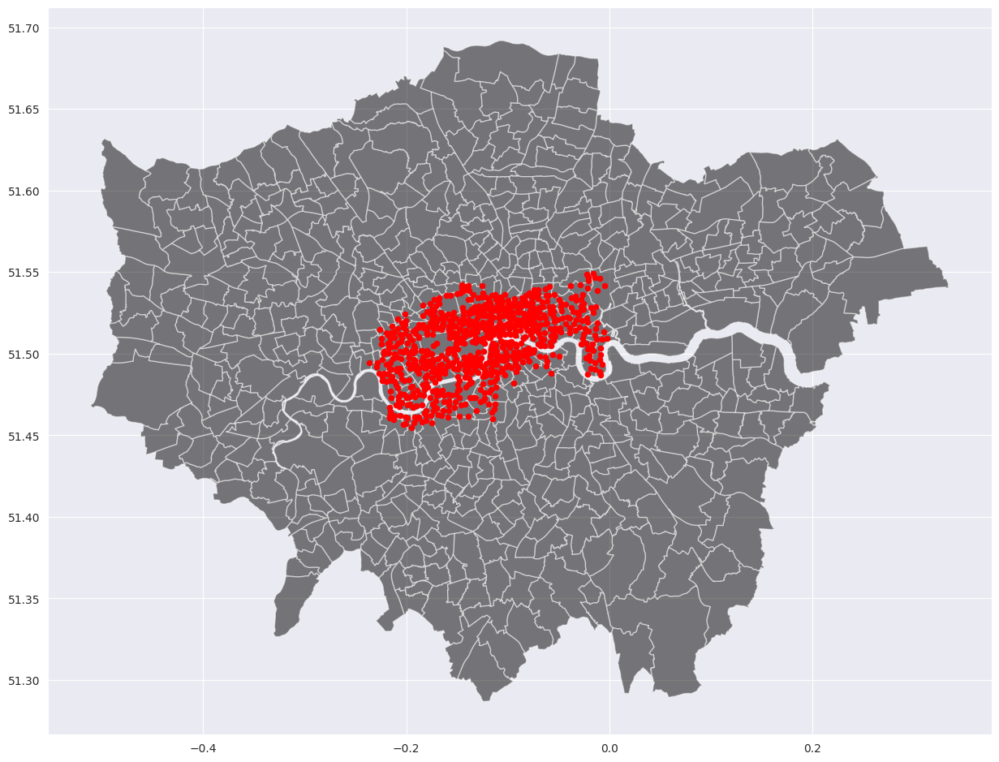

In [ ]:
# @title Explore the station locations

geo_df = create_geodataframe(stg_cycle_stations, stg_cycle_stations['geometry'])

fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax=ax, alpha=0.5, color='black')
geo_df.plot(ax=ax,
            markersize=20,
            color='red',
            marker='o',
            label='Stations')

- Very good saturation mostly downtown London

<Axes: >

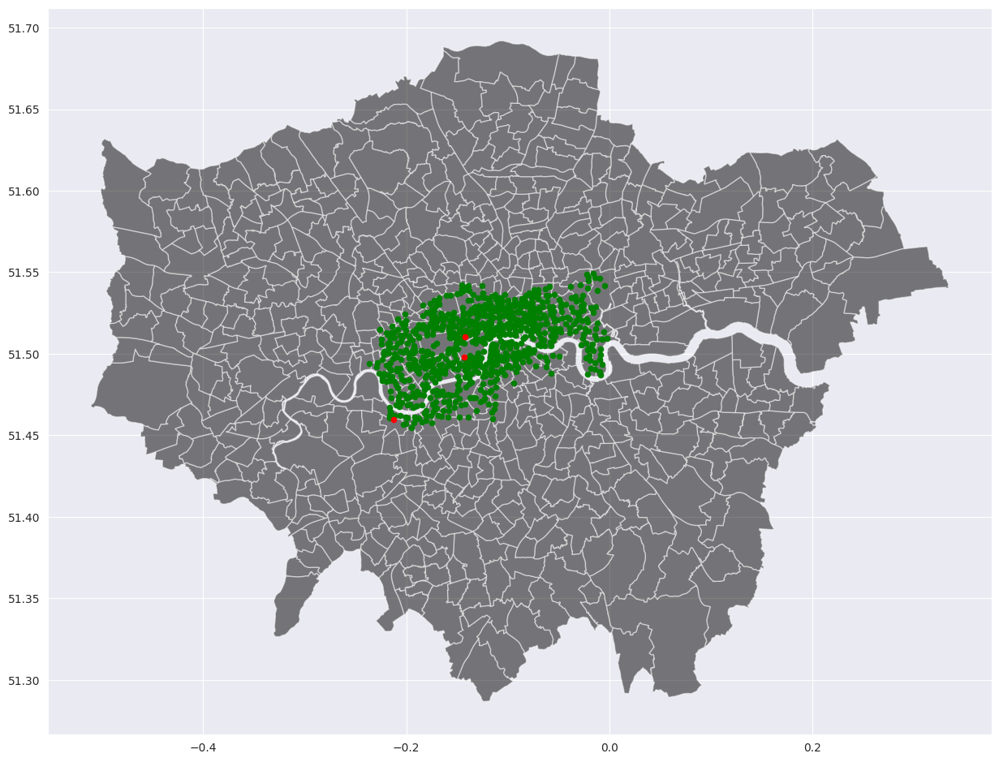

In [ ]:
# @title Inspect removed stations

fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax=ax, alpha=0.5, color='black')
geo_df[geo_df['removal_date'].isnull()].plot(ax=ax,
                                              markersize=20,
                                              color='green',
                                              marker='o',
                                              label='Not Removed')
geo_df[geo_df['removal_date'].notnull()].plot(ax=ax,
                                              markersize=20,
                                              color='red',
                                              marker='o',
                                              label='Removed')


- 2 removed stations downtown (oversaturation?)
- 1 removed station further

## Overall learnings

- the id field, the name and the terminal_name fields are unique identifiers
- 795 unique stations installed between 2010-06-19 and 2022-10-17
- None of them are locked
- 3 temporary stations out of which one was removed in 2018
- 3 stations were removed in total in 2018
- The average bike count across all stations is 14 the average dock count is 24.5  and the average number of docks empty is 12.5
- The avg. distance from the center is 4 km, the min being 0.2 and the max being 9.6
- 2 removed stations downtown (oversaturation?)

# Inspect and explore cycle_hire

In [ ]:
# @title Pull the previously created cycle_hire_source into a Dataframe
cycle_hire_source = client.query('''
  SELECT
    *
  FROM
    take_home_test.cycle_hire_source
''').to_dataframe()

In [ ]:
# @title Inspect cycle_hire_source

with pd.option_context('display.max_columns', None):
    first_looking(cycle_hire_source)
    duplicate_values(cycle_hire_source)
    describe_dataframe(cycle_hire_source)

Shape:(83434866, 14)
There is 83434866 observation and 14 columns in the dataset.
-------------------------------------------------------------------------------
Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83434866 entries, 0 to 83434865
Data columns (total 14 columns):
 #   Column                          Dtype              
---  ------                          -----              
 0   rental_id                       Int64              
 1   duration                        Int64              
 2   duration_ms                     Int64              
 3   bike_id                         Int64              
 4   bike_model                      object             
 5   end_date                        datetime64[ns, UTC]
 6   end_station_id                  Int64              
 7   end_station_name                object             
 8   start_date                      datetime64[ns, UTC]
 9   start_station_id                Int64              
 10  start_station_name         

- rental_id is the unique identifies of the table
- the average bike had ~2616 trib during the whole timeframe
- there are 1629 unique station_ids and 957 unique station names, which doesn't match the 795 found in the stations table
- a lot of missing values all over the board
- no duplicated
- avg. duration is ~1308 seconds, meanwhile the mode is only 840, indicates a very tilted distribution
- there are negative duration values and the max is also unreasonable (probable cause for the big distance between the mean and the mode) - need to be investigated


In [ ]:
cycle_hire_source.head()

,rental_id,duration,duration_ms,bike_id,bike_model,end_date,end_station_id,end_station_name,start_date,start_station_id,start_station_name,end_station_logical_terminal,start_station_logical_terminal,end_station_priority_id
0,49568162,3000,3000000,6826,,2015-11-12 16:21:00+00:00,558,"Page Street, Westminster",2015-11-12 15:31:00+00:00,166,"Seville Street, Knightsbridge",<NA>,<NA>,<NA>
1,126939443,1730,1730221,52506,CLASSIC,2022-11-19 19:54:00+00:00,1160,"Craven Street, Strand",2022-11-19 19:25:00+00:00,1075,"Hyde Park Corner, Hyde Park",<NA>,<NA>,<NA>
2,68311776,793,793000,3509,None,2017-08-11 18:43:00+00:00,214,"Endsleigh Gardens, Euston",2017-08-11 18:30:00+00:00,120,"The Guildhall, Guildhall",<NA>,<NA>,<NA>
3,127576100,1486,1485878,54378,CLASSIC,2022-12-21 08:15:00+00:00,1056,"Finsbury Square , Moorgate",2022-12-21 07:50:00+00:00,300232,"Riverlight South, Nine Elms",<NA>,<NA>,<NA>
4,84514656,4740,4740000,15055,None,2019-02-23 18:02:00+00:00,350,"Queen's Gate, Kensington Gardens",2019-02-23 16:43:00+00:00,350,"Queen's Gate, Kensington Gardens",<NA>,<NA>,<NA>


In [ ]:
# @title Additional checks

### bike_model

client.query('''
  SELECT
    bike_model,
    count(1) as count
  FROM
    take_home_test.cycle_hire_source
  GROUP BY
    1
''').to_dataframe()

# recode empty to nulls

,bike_model,count
0,CLASSIC,2254688
1,PBSC_EBIKE,132035
2,None,56678942
3,,24369201


In [4]:
client.query('''
  SELECT
    bike_model,
    min(start_date) as min_date
  FROM
    take_home_test.cycle_hire_source
  GROUP BY
    1
''').to_dataframe()

,bike_model,min_date
0,,2015-01-04 00:00:00+00:00
1,PBSC_EBIKE,2022-09-14 09:18:00+00:00
2,CLASSIC,2022-09-12 05:02:00+00:00
3,None,2017-06-14 00:00:00+00:00


- 2 different bike types: classic and ebike
- lot of missing values, however some of them are coded as empty strings - need to be fixed
- Data is only captured from 2022-09-12 for the classic and 2022-09-14 for the ebike

## Investigate station ids, logical terminals and station_names

In [ ]:
# @title Stations ids and logical terminals per station_names

client.query('''
SELECT
  start_station_name,
  count(distinct start_station_id) as unique_start_station_id,
  count(distinct start_station_logical_terminal) as unique_start_station_logical_terminal
FROM
  take_home_test.cycle_hire_source
GROUP BY
  1
ORDER BY
  2 desc
''').to_dataframe()

,start_station_name,unique_start_station_id,unique_start_station_logical_terminal
0,"Bourne Street, Belgravia",3,1
1,"Sun Street, Liverpool Street",3,1
2,"Albert Gate, Hyde Park",2,1
3,"Goldsmith's Row, Haggerston",2,1
4,"Bevington Road West, North Kensington",2,1
...,...,...,...
949,"Christian Street, Whitechapel",1,1
950,"Cleveland Way, Bethnal Green",1,0
951,"Pitfield Street (North),Hoxton",1,0
952,"Normand Park, Fulham",1,0


- Many stations has multiple station_ids

In [ ]:
# @title Further investigation into station_name vs station_id vs station_logical terminal

client.query('''
SELECT
  start_station_name,
  start_station_id,
  start_station_logical_terminal,
  min(start_date) as min_start_date,
  max(start_date) as max_start_date
FROM
  take_home_test.cycle_hire_source
GROUP BY
  1, 2, 3
order by
  1, 4;
''').to_dataframe()

,start_station_name,start_station_id,start_station_logical_terminal,min_start_date,max_start_date
0,"Abbey Orchard Street, Westminster",108,<NA>,2015-01-04 11:20:00+00:00,2022-09-09 20:44:00+00:00
1,"Abbey Orchard Street, Westminster",<NA>,3429,2016-08-31 07:08:00+00:00,2016-09-06 23:40:00+00:00
2,"Abbey Orchard Street, Westminster",3429,<NA>,2022-09-12 06:25:00+00:00,2023-01-15 17:00:00+00:00
3,"Abbotsbury Road, Holland Park",559,<NA>,2015-01-04 12:05:00+00:00,2022-09-09 18:51:00+00:00
4,"Abbotsbury Road, Holland Park",<NA>,200111,2016-08-31 14:50:00+00:00,2016-09-06 19:59:00+00:00
...,...,...,...,...,...
2527,"York Hall, Bethnal Green",<NA>,200042,2016-08-31 00:13:00+00:00,2016-09-06 23:35:00+00:00
2528,"York Hall, Bethnal Green",200042,<NA>,2022-09-12 11:47:00+00:00,2023-01-15 22:28:00+00:00
2529,"York Way, Camden",836,<NA>,2018-08-23 09:07:00+00:00,2018-08-23 09:07:00+00:00
2530,"York Way, Kings Cross",836,<NA>,2018-09-06 13:14:00+00:00,2022-09-09 19:49:00+00:00



- Multiple ids introduced in 2016-08-31 first as logical_terminal then as ids, they are running parallel - this needs to be handled

In [ ]:
# @title Inspect missing start_stations ids

client.query('''
SELECT
  count(distinct start_station_name) as unique_start_station_names,
  count(distinct start_station_logical_terminal) as unique_start_station_logical_terminal,
  min(start_date) as min_start_date,
  max(start_date) as max_start_date
FROM
  take_home_test.cycle_hire_source
WHERE
  start_station_id is NULL
''').to_dataframe()

# logical terminal always present when id is missing, only between 2016-08-31 and 2016-09-06
# backfill this

,unique_start_station_names,unique_start_station_logical_terminal,min_start_date,max_start_date
0,777,777,2016-08-31 00:00:00+00:00,2016-09-06 23:59:00+00:00


- logical terminal always present when id is missing, only between 2016-08-31 and 2016-09-06 - this can be backfilled

In [ ]:
# @title Inspect missing end_stations ids

client.query('''
SELECT
  count(distinct end_station_name) as unique_end_station_names,
  count(distinct end_station_logical_terminal) as unique_end_station_logical_terminal,
  min(end_date) as min_end_date,
  max(end_date) as max_end_date
FROM
  take_home_test.cycle_hire_source
WHERE
  end_station_id is NULL
''').to_dataframe()

# doesnt apply the other way around

,unique_end_station_names,unique_end_station_logical_terminal,min_end_date,max_end_date
0,838,778,2016-08-31 00:05:00+00:00,2022-07-12 23:59:00+00:00


- this doesn't apply the other way around - some missing end_station_names don't have a logical terminal

In [5]:
# @title Compare missing id from cyce_hire_source to cycle_stations_source

missing_id = client.query('''
SELECT * FROM take_home_test.cycle_hire_source where start_station_id = 407 or start_station_logical_terminal = 407
''').to_dataframe()

In [13]:
missing_id.head()

,rental_id,duration,duration_ms,bike_id,bike_model,end_date,end_station_id,end_station_name,start_date,start_station_id,start_station_name,end_station_logical_terminal,start_station_logical_terminal,end_station_priority_id
0,51062910,4080,4080000,7197,,2016-01-24 16:08:00+00:00,266,"Queen's Gate (North), Kensington",2016-01-24 15:00:00+00:00,407,"Speakers' Corner 1, Hyde Park",<NA>,<NA>,<NA>
1,42420062,37440,37440000,1307,,2015-04-09 07:15:00+00:00,290,"Winsland Street, Paddington",2015-04-08 20:51:00+00:00,407,"Speakers' Corner 1, Hyde Park",<NA>,<NA>,<NA>
2,44387889,5580,5580000,7569,,2015-06-10 20:38:00+00:00,36,"De Vere Gardens, Kensington",2015-06-10 19:05:00+00:00,407,"Speakers' Corner 1, Hyde Park",<NA>,<NA>,<NA>
3,52448344,6420,6420000,9132,,2016-03-27 19:46:00+00:00,294,"St. George's Square, Pimlico",2016-03-27 17:59:00+00:00,407,"Speakers' Corner 1, Hyde Park",<NA>,<NA>,<NA>
4,46057016,3720,3720000,4421,,2015-07-23 23:34:00+00:00,301,"Marylebone Lane, Marylebone",2015-07-23 22:32:00+00:00,407,"Speakers' Corner 1, Hyde Park",<NA>,<NA>,<NA>


In [14]:
print(missing_id.start_station_name[0])
print(missing_id.shape[0])
print(missing_id['start_date'].min())
print(missing_id['start_date'].max())

Speakers' Corner 1, Hyde Park
85835
2015-01-04 10:18:00+00:00
2016-08-24 20:20:00+00:00


In [19]:
client.query('''
SELECT * FROM take_home_test.cycle_stations_source where id = 407 or CAST(terminal_name AS INT) = 407
''').to_dataframe()

,id,installed,latitude,locked,longitude,name,bikes_count,docks_count,nbEmptyDocks,temporary,terminal_name,install_date,removal_date


In [20]:
client.query('''
SELECT * from take_home_test.cycle_stations_source where name = "Speakers' Corner 1, Hyde Park" or name like lower('%speakers%')
''').to_dataframe()

,id,installed,latitude,locked,longitude,name,bikes_count,docks_count,nbEmptyDocks,temporary,terminal_name,install_date,removal_date


- while Speakers' Corner 1, Hyde Park has 85835 accurances between 2015-01-04 and 2016-08-24 in the hire table, it's not present in the stations table neither by name or by id at all
- this is not the only case, hence the differnece between unique ids and names between the 2 datasets

## Investigate durations

In [ ]:
# @title Check max durations
client.query('''
SELECT
  rental_id,
  start_date,
  end_date,
  duration_min,
  duration_h,
  start_station_name,
  end_station_name
FROM
  (
  SELECT
    rental_id,
    start_station_name,
    end_station_name,
    round(duration / 60, 1) as duration_min,
    round(duration / 60 / 60, 2) as duration_h,
    start_date,
    end_date
  FROM
    take_home_test.cycle_hire_source
  ) AS temp
ORDER BY
  duration_min DESC
LIMIT 100
''').to_dataframe()

# shouldn't go past 24h

,rental_id,start_date,end_date,duration_min,duration_h,start_station_name,end_station_name
0,126774197,2022-11-13 01:21:00+00:00,2023-01-17 08:26:00+00:00,94025.5,1567.09,"Westbourne Park Road, Portobello","West Smithfield Rotunda, Farringdon"
1,125148240,2022-09-15 19:21:00+00:00,2022-11-18 18:06:00+00:00,92145.4,1535.76,"Panton Street, West End",Mechanical Workshop Clapham
2,126746579,2022-11-12 03:41:00+00:00,2023-01-13 15:05:00+00:00,89964.4,1499.41,"Royal London Hospital, Whitechapel","Risinghill Street, Angel"
3,126795788,2022-11-14 01:51:00+00:00,2023-01-13 17:14:00+00:00,87322.7,1455.38,"Frith Street, Soho","Maplin Street, Mile End"
4,125108069,2022-09-14 16:22:00+00:00,2022-11-12 09:21:00+00:00,84599.1,1409.98,"Westbridge Road, Battersea","Elizabeth Bridge, Victoria"
...,...,...,...,...,...,...,...
95,43163729,2015-05-03 00:23:00+00:00,2015-05-27 00:46:00+00:00,34583.0,576.38,"Albert Embankment, Vauxhall","Kennington Road Post Office, Oval"
96,50394766,2015-12-18 17:22:00+00:00,2016-01-11 14:31:00+00:00,34389.0,573.15,"Notting Hill Gate Station, Notting Hill",Mechanical Workshop Penton
97,50418355,2015-12-19 18:30:00+00:00,2016-01-12 15:38:00+00:00,34388.0,573.13,"Archbishop's Park, Waterloo","Everington Street, Fulham"
98,125102397,2022-09-14 12:12:00+00:00,2022-10-08 07:11:00+00:00,34259.4,570.99,"Bevington Road West, North Kensington","Bevington Road West, North Kensington"


In [ ]:
### Check max durations above 24h
over_24h = client.query('''
  SELECT
    count(1)
  FROM
    take_home_test.cycle_hire_source
  WHERE
    round(duration / 60 / 60, 2) > 24
''').to_dataframe()

print('Number of rentals going over 24h:', over_24h.iloc[0, 0])
print('Share of rentals going over 24h vs total rentals:', round((over_24h.iloc[0, 0]/ 83434865)*100, 4), '%')

# shouldn't go past 24h (on paper) but 27546

Number of rentals going over 24h: 27546
Share of rentals going over 24h vs total rentals: 0.033 %


- Many records skewing the average with huge duration times (eg. 27546 rows are going over 1 day)
- Although this is a small overall % (0.033%) - there might be a market for catering to these users

In [ ]:
# @title Negative durations
client.query('''
SELECT
    rental_id,
    start_station_name,
    end_station_name,
    duration,
    start_date,
    end_date
FROM
  take_home_test.cycle_hire_source
WHERE
  duration < 0
''').to_dataframe().head(10)

,rental_id,start_station_name,end_station_name,duration,start_date,end_date
0,70877247,"London Zoo Car Park, The Regent's Park","Northdown Street, King's Cross",-2040,2017-10-29 01:37:00+00:00,2017-10-29 01:03:00+00:00
1,49063674,"Regent's Row , Haggerston","Risinghill Street, Angel",-1920,2015-10-25 01:41:00+00:00,2015-10-25 01:09:00+00:00
2,49063722,"Appold Street, Liverpool Street","Jubilee Street, Stepney",-2760,2015-10-25 01:56:00+00:00,2015-10-25 01:10:00+00:00
3,49063724,"Wellington Arch, Hyde Park","Hatton Garden, Holborn",-1560,2015-10-25 01:56:00+00:00,2015-10-25 01:30:00+00:00
4,70877339,"Lambeth Palace Road, Waterloo","Union Grove, Wandsworth Road",-2820,2017-10-29 01:57:00+00:00,2017-10-29 01:10:00+00:00
5,59897948,"Wardour Street, Soho","South Kensington Station, South Kensington",-1020,2016-10-30 01:30:00+00:00,2016-10-30 01:13:00+00:00
6,59898069,"Farm Street, Mayfair","Hereford Road, Bayswater",-2400,2016-10-30 01:42:00+00:00,2016-10-30 01:02:00+00:00
7,59898092,"Charles II Street, West End","Knaresborough Place, Earl's Court",-1320,2016-10-30 01:44:00+00:00,2016-10-30 01:22:00+00:00
8,49063670,"Brushfield Street, Liverpool Street","Wendon Street, Old Ford",-420,2015-10-25 01:40:00+00:00,2015-10-25 01:33:00+00:00
9,70877318,"Canton Street, Poplar","Bow Church Station, Bow",-2760,2017-10-29 01:51:00+00:00,2017-10-29 01:05:00+00:00


- There seems to be a pattern for the negative duration times in regarding of starting and ending dates

In [ ]:
### Further investigation into neg durations
client.query('''
SELECT
  date(start_date) as start_date,
  EXTRACT(HOUR FROM start_date) as start_hour,
  EXTRACT(WEEK FROM start_date) as start_week,
  date(end_date) as end_date,
  EXTRACT(HOUR FROM end_date) as start_hour,
  count(distinct rental_id) as rentals
FROM
  take_home_test.cycle_hire_source
where
  duration  < 0
GROUP BY
  1, 2, 3, 4, 5
''').to_dataframe()

# only 3 date, all last sunday of oct, change of clock?

,start_date,start_hour,start_week,end_date,start_hour_1,rentals
0,2015-10-25,1,43,2015-10-25,1,56
1,2017-10-29,1,44,2017-10-29,1,74
2,2016-10-30,1,44,2016-10-30,1,108


- All these cases are on 3 dates, which are all the last sunday of an october in the given year. This corresponds to the changing the of clocks - could be fixed

In [ ]:
# @title Missing duration
client.query('''
SELECT
  rental_id,
  start_station_name,
  end_station_name,
  duration,
  start_date,
  end_date
FROM
  take_home_test.cycle_hire_source
WHERE
  duration is null
''').to_dataframe().head(10)

,rental_id,start_station_name,end_station_name,duration,start_date,end_date
0,66635842,"Bedford Way, Bloomsbury",None,<NA>,2017-06-27 15:38:00+00:00,NaT
1,66825829,"Bruton Street, Mayfair",None,<NA>,2017-07-02 16:12:00+00:00,NaT
2,67363914,"Goldsmith's Row, Haggerston",None,<NA>,2017-07-15 11:02:00+00:00,NaT
3,66411900,"BBC White City, White City",None,<NA>,2017-06-21 18:37:00+00:00,NaT
4,67065694,"Marylebone Lane, Marylebone",None,<NA>,2017-07-07 18:36:00+00:00,NaT
5,66975644,"Cartwright Gardens , Bloomsbury",None,<NA>,2017-07-05 19:41:00+00:00,NaT
6,66317989,"Duke Street Hill, London Bridge",None,<NA>,2017-06-19 18:16:00+00:00,NaT
7,67212717,"Antill Road, Mile End",None,<NA>,2017-07-11 08:46:00+00:00,NaT
8,67266696,"Queen's Gate (North), Kensington",None,<NA>,2017-07-12 20:06:00+00:00,NaT
9,67909177,"Black Lion Gate, Kensington Gardens",None,<NA>,2017-07-30 17:40:00+00:00,NaT


In [ ]:
## Missing duration further investigation
client.query('''
SELECT
  end_station_name,
  end_date,
  count(1) as count
FROM
  take_home_test.cycle_hire_source
WHERE
  duration is null
GROUP BY
  1, 2
''').to_dataframe()


,end_station_name,end_date,count
0,"Timber Lodge, Queen Elizabeth Olympic Park",NaT,3
1,"Maclise Road, Olympia",NaT,1
2,"Heron Quays DLR, Canary Wharf",NaT,1
3,"Howick Place, Westminster",NaT,2
4,"Greenland Road, Camden Town",NaT,1
5,"Chelsea Bridge, Pimlico",NaT,2
6,"Union Grove, Wandsworth Road",NaT,1
7,"Stephendale Road, Sands End",NaT,2
8,"Doddington Grove, Kennington",NaT,1
9,"Manresa Road, Chelsea",NaT,1


- 34 different end_stations has missing durations and end dates, bug?
- however, in the majority of the cases the end_station is also missing - stolen bikes?

# **London weather data**

In [22]:
# @title Pull the weatherstats_london_source

### source: https://www.kaggle.com/datasets/hmavrodiev/london-bike-sharing-dataset?resource=download
### this was uploaded to BigQuery as a table called weatherstats_london_source
weather_data_source = client.query('''
SELECT
  *
FROM
  take_home_test.weatherstats_london_source
''').to_dataframe()

In [ ]:
# @title Inspect the weatherstats_london_source
with pd.option_context('display.max_columns', None):
    first_looking(weather_data_source)
    duplicate_values(weather_data_source)
    describe_dataframe(weather_data_source)

Shape:(17414, 10)
There is 17414 observation and 10 columns in the dataset.
-------------------------------------------------------------------------------
Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17414 entries, 0 to 17413
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype              
---  ------        --------------  -----              
 0   timestamp     17414 non-null  datetime64[ns, UTC]
 1   cnt           17414 non-null  Int64              
 2   t1            17414 non-null  float64            
 3   t2            17414 non-null  float64            
 4   hum           17414 non-null  float64            
 5   wind_speed    17414 non-null  float64            
 6   weather_code  17414 non-null  float64            
 7   is_holiday    17414 non-null  float64            
 8   is_weekend    17414 non-null  float64            
 9   season        17414 non-null  float64            
dtypes: Int64(1), datetime64[ns, UTC](1), float64(8)
memory usage: 1

In [ ]:
weather_data_source.head()

,timestamp,cnt,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season
0,2015-01-19 22:00:00+00:00,356,2.0,1.0,75.0,3.0,2.0,0.0,0.0,3.0
1,2015-01-22 01:00:00+00:00,81,2.0,2.0,87.0,2.0,2.0,0.0,0.0,3.0
2,2015-01-22 19:00:00+00:00,1350,2.0,0.0,70.0,6.5,2.0,0.0,0.0,3.0
3,2015-02-05 01:00:00+00:00,84,2.0,-1.5,87.0,13.0,2.0,0.0,0.0,3.0
4,2015-02-05 19:00:00+00:00,1316,2.0,-2.0,75.0,16.0,2.0,0.0,0.0,3.0


In [ ]:
# Find the minimum and maximum values
min_timestamp = weather_data_source['timestamp'].min()
max_timestamp = weather_data_source['timestamp'].max()

print("Minimum Timestamp:", min_timestamp)
print("Maximum Timestamp:", max_timestamp)

Minimum Timestamp: 2015-01-04 00:00:00+00:00
Maximum Timestamp: 2017-01-03 23:00:00+00:00


- The pulled in weather data goes from 2015-01-04 to 2017-01-03
- Has fields for hourly real and percieved temperature, humidity, wind speed, weather code and indications for holidays, weekends and season
- There also is a field for the count of rentals in the given hour, but I'll drop this later and use the one that was given in the cycle_hire_source (the 2 matches for this period though)

In [27]:
fig = px.pie(weather_data_source, values=weather_data_source['weather_code'].value_counts().values,
             names= ['Clear', 'scattered clouds', 'Cloudy', 'Rain', 'Rain with thunderstorm', 'Snowfall', 'Freezing Fog'])
fig.show()

- Paring the codes to the different weathers we get a farily accudate picture of London's weather

# **Putting it all together**

Create the stg_cycle_hire staging table incorporating fixes to issues found earlier. Eg:
- fixing the negative durations
- recoding empty strings to nulls
- adding additional date features
- backfilling the station_ids with the logical terminals etc

In [ ]:
# @title Create stg_cycle_hire
stg_cycle_hire = client.query('''
with data as (
SELECT
  rental_id,
  CASE
    WHEN duration  < 0 and date(start_date) in ('2015-10-25', '2016-10-30', '2017-10-29') and EXTRACT(HOUR FROM start_date) = 1 and EXTRACT(HOUR FROM end_date) = 1 THEN TIMESTAMP_DIFF(date_add(end_date, INTERVAL 1 HOUR), start_date, SECOND)
    ELSE duration
    END as duration_sec,   -- fixing the negative durations due to the clock changes as per the prior findings
  bike_id,
  CASE WHEN bike_model = '' THEN NULL ELSE bike_model END as bike_model,
  CASE WHEN bike_model = 'PBSC_EBIKE' THEN 1
       WHEN bike_model = 'CLASSIC' THEN 0
       ELSE null
       END as is_ebike,    -- recode '' to nulls
  start_date,
  -- create additional date features
  CASE WHEN EXTRACT(DAYOFWEEK FROM start_date) = 1 THEN 7 ELSE EXTRACT(DAYOFWEEK FROM start_date) - 1 END as start_day_of_week,
  CASE WHEN EXTRACT(DAYOFWEEK FROM start_date) in (1, 7) THEN 1 ELSE 0 END start_is_weekend,
  CASE
    WHEN EXTRACT(MONTH FROM start_date) in (3, 4, 5) THEN 1
    WHEN EXTRACT(MONTH FROM start_date) in (6, 7, 8) THEN 2
    WHEN EXTRACT(MONTH FROM start_date) in (9, 10, 11) THEN 3
    WHEN EXTRACT(MONTH FROM start_date) in (12, 1, 2) THEN 4
    END as start_season,
  start_station_id,
  coalesce(start_station_id, start_station_logical_terminal) as start_station_id_backfilled,  -- backfill the missing station_ids with the logical terminal
  start_station_name,
  start_station_logical_terminal,
  end_date,
  end_station_id,
  coalesce(end_station_id, end_station_logical_terminal) as end_station_id_backfilled, -- backfill the missing station_ids with the logical terminal
  end_station_name,
  end_station_logical_terminal,
  end_station_priority_id,
  CASE WHEN start_station_id = end_station_id THEN 1 ELSE 0 END as is_same_station
FROM
  take_home_test.cycle_hire_source
)

SELECT
  rental_id,
  duration_sec,
  duration_sec / 60 as duration_min,
  duration_sec / 60 / 60 as duration_h,
  CASE WHEN duration_sec / 60 / 60  > 24 THEN 1 ELSE 0 END as is_over_a_day,
  bike_id,
  bike_model,
  is_ebike,
  start_date as start_date_time,
  start_day_of_week,
  start_is_weekend,
  start_season,
  start_station_id,
  start_station_id_backfilled,
  start_station_name,
  start_station_logical_terminal,
  end_date as end_date_time,
  end_station_id,
  end_station_id_backfilled,
  end_station_name,
  end_station_logical_terminal,
  end_station_priority_id,
  is_same_station
FROM
  data
''').to_dataframe()

In [ ]:
stg_cycle_hire.head()

,rental_id,duration_sec,duration_min,duration_h,is_over_a_day,bike_id,bike_model,is_ebike,start_date_time,start_day_of_week,...,start_station_id_backfilled,start_station_name,start_station_logical_terminal,end_date_time,end_station_id,end_station_id_backfilled,end_station_name,end_station_logical_terminal,end_station_priority_id,is_same_station
0,125821933,438,7.30,0.121667,0,41470,CLASSIC,0,2022-10-10 08:42:00+00:00,1,...,1190,"Kennington Lane Rail Bridge, Vauxhall",<NA>,2022-10-10 08:50:00+00:00,3480,3480,"Smith Square, Westminster",<NA>,<NA>,0
1,44744378,7980,133.00,2.216667,0,3170,None,<NA>,2015-06-20 17:22:00+00:00,6,...,777,"Limburg Road, Clapham Junction",<NA>,2015-06-20 19:35:00+00:00,724,724,"Alma Road, Wandsworth",<NA>,<NA>,0
2,126048955,309,5.15,0.085833,0,52526,CLASSIC,0,2022-10-17 19:58:00+00:00,1,...,200230,"Maplin Street, Mile End",<NA>,2022-10-17 20:03:00+00:00,200027,200027,"Ford Road, Old Ford",<NA>,<NA>,0
3,121991357,1980,33.00,0.550000,0,10449,None,<NA>,2022-06-28 10:41:00+00:00,2,...,289,"South Audley Street, Mayfair",<NA>,2022-06-28 11:14:00+00:00,292,292,"Montpelier Street, Knightsbridge",<NA>,<NA>,0
4,71481899,1980,33.00,0.550000,0,13732,None,<NA>,2017-11-19 16:07:00+00:00,7,...,296,"Knaresborough Place, Earl's Court",<NA>,2017-11-19 16:40:00+00:00,222,222,"Knightsbridge, Hyde Park",<NA>,<NA>,0


Create the dim_cycle_data dimension table combining the previously created stg_cycle_hire and stg_cycle_stations tables

Removed some fields that won't be used during this analysis to save resources, however in a real scenario everything would be kept

In [4]:
# @title Create dim_cycle_data
dim_cycle_data = client.query('''
/*
with sample as (
  SELECT * FROM take_home_test.stg_cycle_hire -- WHERE date(start_date_time) between date('2020-01-01') and date('2021-12-31')
)
*/

with data as (
SELECT
  rental_id,
  duration_min,
  is_over_a_day,
  bike_id,
  bike_model,
  is_ebike,
  start_date_time,
  start_day_of_week,
  start_is_weekend,
  start_season,
  start_station_id_backfilled,
  start_station_name,
  ss.name as start_station_name_stations,
  ss.latitude as start_station_latitude,
  ss.longitude as start_station_longitude,
  --ss.locked as start_station_locked,
  ss.bikes_count as start_station_bikes_count,
  ss.docks_count as start_station_docks_count,
  ss.nbEmptyDocks as start_station_empty_docks,
  --ss.temporary as is_start_station_temporary,
  --ss.install_date as start_station_install_date,
  --ss.removal_date as start_station_removal_date,
  ss.distance_from_city_center as start_station_distance_from_city_center,
  end_date_time,
  end_station_id_backfilled,
  es.name as end_station_name_station,
  end_station_name,
  es.latitude as end_station_latitude,
  es.longitude as end_station_longitude,
  --es.locked as end_station_locked,
  es.bikes_count as end_station_bikes_count,
  es.docks_count as end_station_docks_count,
  es.nbEmptyDocks as end_station_empty_docks,
  --es.temporary as is_end_station_temporary,
  --es.install_date as end_station_install_date,
  --es.removal_date as end_station_removal_date,
  es.distance_from_city_center as end_station_distance_from_city_center,
  is_same_station,
FROM
  take_home_test.stg_cycle_hire ch
LEFT JOIN
  take_home_test.stg_cycle_stations ss on ss.id = ch.start_station_id_backfilled or CAST(ss.terminal_name AS INT) = ch.start_station_id_backfilled
LEFT JOIN
  take_home_test.stg_cycle_stations es on es.id = ch.end_station_id_backfilled or CAST(es.terminal_name AS INT) = ch.end_station_id_backfilled
)

, rollup_station_names as (
SELECT
  *,
  FIRST_VALUE(start_station_name) OVER (PARTITION BY start_station_id_backfilled ORDER BY start_station_id_backfilled desc) as start_station_name2,
  FIRST_VALUE(end_station_name) OVER (PARTITION BY end_station_id_backfilled ORDER BY end_station_id_backfilled desc) as end_station_name2
FROM
  data
)

, rollup_station_ids as (
SELECT
  *,
  FIRST_VALUE(start_station_id_backfilled) OVER (PARTITION BY start_station_name2 ORDER BY start_date_time asc) as start_station_id_backfilled2,
  FIRST_VALUE(end_station_id_backfilled) OVER (PARTITION BY end_station_name2 ORDER BY end_date_time asc) as end_station_id_backfilled2
FROM
  rollup_station_names
)

SELECT
  rental_id,
  duration_min,
  is_over_a_day,
  bike_id,
  bike_model,
  is_ebike,
  start_date_time,
  start_day_of_week,
  start_is_weekend,
  start_season,
  start_station_id_backfilled2 as start_station_id_backfilled,
  start_station_name2 as start_station_name,
  start_station_latitude,
  start_station_longitude,
  --start_station_locked,
  start_station_bikes_count,
  start_station_docks_count,
  start_station_empty_docks,
  --is_start_station_temporary,
  --start_station_install_date,
  --start_station_removal_date,
  start_station_distance_from_city_center,
  end_date_time,
  end_station_id_backfilled2 as start_station_id_backfilled,
  end_station_name2 as end_station_name,
  end_station_latitude,
  end_station_longitude,
  --end_station_locked,
  end_station_bikes_count,
  end_station_docks_count,
  end_station_empty_docks,
  --is_end_station_temporary,
  --end_station_install_date,
  --end_station_removal_date,
  end_station_distance_from_city_center,
  is_same_station
FROM
  rollup_station_ids
''').to_dataframe()

In [5]:
dim_cycle_data[['start_station_id_backfilled', 'start_station_name']].groupby(['start_station_id_backfilled', 'start_station_name']).size().reset_index(name='count').sort_values(by='start_station_name')

,start_station_id_backfilled,start_station_name,count
106,108,"Abbey Orchard Street, Westminster",121574
539,559,"Abbotsbury Road, Holland Park",38191
385,394,"Aberdeen Place, St. John's Wood",61413
534,554,"Aberfeldy Street, Poplar",21158
561,583,"Abingdon Green, Westminster",138826
...,...,...,...
416,433,"Wren Street, Holborn",134375
154,157,"Wright's Lane, Kensington",151734
802,829,"Wynne Road, Stockwell",25944
427,446,"York Hall, Bethnal Green",122406


In [6]:
dim_cycle_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83434866 entries, 0 to 83434865
Data columns (total 28 columns):
 #   Column                                   Dtype              
---  ------                                   -----              
 0   rental_id                                Int64              
 1   duration_min                             float64            
 2   is_over_a_day                            Int64              
 3   bike_id                                  Int64              
 4   bike_model                               object             
 5   is_ebike                                 Int64              
 6   start_date_time                          datetime64[ns, UTC]
 7   start_day_of_week                        Int64              
 8   start_is_weekend                         Int64              
 9   start_season                             Int64              
 10  start_station_id_backfilled              Int64              
 11  start_station_name    

In [32]:
# @title Create dim_cycle_stations
dim_cycle_stations = client.query('''
SELECT
  start_station_name as station_name,
  start_station_id_backfilled as station_id,
  start_station_longitude as longitude,
  start_station_latitude as latitude,
  start_station_distance_from_city_center as distance_from_city_center,
  start_station_docks_count as docks_count,
  start_station_bikes_count as bikes_count,
  start_station_empty_docks as empty_docks
FROM
  take_home_test.dim_cycle_data_rollup
WHERE
  start_station_longitude is not null
GROUP BY
  1, 2, 3, 4, 5, 6, 7, 8
ORDER BY
  1, 2
  ''').to_dataframe()

In [4]:
# @title Create drv_fact_cycle_data
drv_fact_cycle_data = client.query('''
SELECT
  timestamp_trunc(start_date_time, HOUR) as start_date_time,
  start_day_of_week,
  start_is_weekend,
  start_season,
  start_station_id_backfilled,
  start_station_name,
  start_station_latitude,
  start_station_longitude,
  --start_station_locked,
  start_station_bikes_count,
  start_station_docks_count,
  start_station_empty_docks,
  start_station_distance_from_city_center,
  --ss.temporary as is_start_station_temporary,
  --ss.install_date as start_station_install_date,
  --ss.removal_date as start_station_removal_date,
  timestamp_trunc(end_date_time, HOUR) as end_date_time,
  end_station_id_backfilled,
  end_station_name,
  end_station_latitude,
  end_station_longitude,
  --end_station_locked,
  end_station_bikes_count,
  end_station_docks_count,
  end_station_empty_docks,
  --es.temporary as is_end_station_temporary,
  --es.install_date as end_station_install_date,
  --es.removal_date as end_station_removal_date,
  is_same_station,
  is_over_a_day,
  bike_model,
  is_ebike,
  count(distinct rental_id) as no_of_rentals,
  count(distinct bike_id) as no_of_bikes,
  sum(duration_min) as sum_duration_min
FROM
  take_home_test.dim_cycle_data_rollup
WHERE 1=1
  --and date(start_date_time) between date('2021-01-01') and date('2022-12-31')     -- remove later
GROUP BY
  1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,15, 16, 17, 18, 19, 20, 21, 22, 23, 24
''').to_dataframe()

In [11]:
drv_fact_cycle_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18600336 entries, 0 to 18600335
Data columns (total 27 columns):
 #   Column                                   Dtype              
---  ------                                   -----              
 0   start_date_time                          datetime64[ns, UTC]
 1   start_day_of_week                        Int64              
 2   start_is_weekend                         Int64              
 3   start_season                             Int64              
 4   start_station_id_backfilled              Int64              
 5   start_station_name                       object             
 6   start_station_latitude                   float64            
 7   start_station_longitude                  float64            
 8   start_station_bikes_count                Int64              
 9   start_station_docks_count                Int64              
 10  start_station_empty_docks                Int64              
 11  start_station_distance

In [ ]:
drv_fact_cycle_data.describe()

,start_day_of_week,start_is_weekend,start_season,start_station_id_backfilled,start_station_latitude,start_station_longitude,start_station_bikes_count,start_station_docks_count,start_station_empty_docks,start_station_distance_from_city_center,...,end_station_longitude,end_station_bikes_count,end_station_docks_count,end_station_empty_docks,is_same_station,is_over_a_day,is_ebike,no_of_rentals,no_of_bikes,sum_duration_min
count,71516490.0,71516490.0,71516490.0,71516490.0,6.978398e+07,6.978398e+07,69783979.0,69783979.0,69783979.0,6.978398e+07,...,6.946262e+07,69462621.0,69462621.0,69462621.0,71516490.0,71516490.0,2193420.0,71516490.0,71516490.0,7.149815e+07
mean,3.799612,0.226836,2.378023,3728.51507,5.150775e+01,-1.263021e-01,13.786212,27.44361,13.657397,3.627447e+00,...,-1.260569e-01,13.675446,27.499262,13.823816,0.03187,0.000377,0.059456,1.166652,1.166154,2.543333e+01
std,1.911642,0.418786,1.044994,31503.536834,1.831085e-02,4.913251e-02,10.473366,9.49511,10.532579,1.815731e+00,...,4.884267e-02,10.543711,9.56963,10.611745,0.175654,0.019425,0.236475,0.535569,0.533393,1.376755e+02
min,1.0,0.0,1.0,1.0,5.145475e+01,-2.367699e-01,0.0,10.0,0.0,2.025192e-01,...,-2.367699e-01,0.0,10.0,0.0,0.0,0.0,0.0,1.0,0.0,0.000000e+00
25%,2.0,0.0,2.0,173.0,5.149572e+01,-1.643938e-01,5.0,20.0,5.0,2.234075e+00,...,-1.630416e-01,5.0,20.0,5.0,0.0,0.0,0.0,1.0,1.0,8.000000e+00
50%,4.0,0.0,2.0,354.0,5.151010e+01,-1.246784e-01,12.0,25.0,12.0,3.447676e+00,...,-1.246784e-01,12.0,26.0,12.0,0.0,0.0,0.0,1.0,1.0,1.400000e+01
75%,5.0,0.0,3.0,603.0,5.152096e+01,-9.177378e-02,21.0,33.0,20.0,4.705149e+00,...,-9.177378e-02,21.0,33.0,20.0,0.0,0.0,0.0,1.0,1.0,2.300000e+01
max,7.0,1.0,4.0,3000061.0,5.154937e+01,-2.275000e-03,54.0,64.0,56.0,9.647250e+00,...,-2.275000e-03,54.0,64.0,56.0,1.0,1.0,1.0,38.0,38.0,9.402553e+04


In [ ]:
drv_fact_cycle_data.head()

,start_date_time,start_day_of_week,start_is_weekend,start_season,start_station_id_backfilled,start_station_name,start_station_latitude,start_station_longitude,start_station_locked,start_station_bikes_count,...,end_station_bikes_count,end_station_docks_count,end_station_empty_docks,is_same_station,is_over_a_day,bike_model,is_ebike,no_of_rentals,no_of_bikes,sum_duration_min
0,2022-10-11 21:00:00+00:00,2,0,3,200185,"St. John's Road, Clapham Junction",51.462393,-0.168292,false,30,...,10,28,18,0,0,CLASSIC,0,1,1,7.833333
1,2019-12-10 07:00:00+00:00,2,0,4,669,"Teversham Lane, Stockwell",51.476149,-0.123258,false,30,...,33,35,2,0,0,None,<NA>,1,1,3.000000
2,2016-06-14 10:00:00+00:00,2,0,2,361,"Waterloo Station 2, Waterloo",51.503920,-0.113426,false,54,...,0,16,16,0,0,None,<NA>,1,1,7.000000
3,2017-07-15 08:00:00+00:00,6,1,2,603,"Caldwell Street, Stockwell",51.477839,-0.116493,false,37,...,17,27,10,0,0,None,<NA>,1,1,10.000000
4,2018-08-03 08:00:00+00:00,5,0,2,420,"Southwark Station 1, Southwark",51.504043,-0.105312,false,37,...,0,21,21,0,0,None,<NA>,1,1,5.000000


In [ ]:
drv_fact_cycle_data.no_of_rentals.sum()

83434866

# Most Popular Start and End Stations

## Most popular rental stations

In [12]:
# @title Get data for the most popular rental stations
most_popular_stations_rentals = client.query('''
with start_stations as (
SELECT
  'start_station' as station_type,
  start_station_name as station_name,
  start_station_longitude,
  start_station_latitude,
  start_station_distance_from_city_center as distance_from_city_center,
  sum(no_of_rentals) as no_of_rentals
FROM
  take_home_test.drv_fact_cycle_data
GROUP BY
  1, 2, 3, 4, 5
ORDER BY
  6 desc
LIMIT 10
)

, end_stations as (
SELECT
  'end_station' as station_type,
  end_station_name as station_name,
  end_station_longitude,
  end_station_latitude,
  end_station_distance_from_city_center as distance_from_city_center,
  sum(no_of_rentals) as no_of_rentals
FROM
  take_home_test.drv_fact_cycle_data
GROUP BY
  1, 2, 3, 4, 5
ORDER BY
  6 desc
LIMIT 10
)


SELECT *, rank() OVER (PARTITION BY station_type ORDER BY no_of_rentals desc) as rank_ FROM start_stations
UNION ALL
SELECT *, rank() OVER (PARTITION BY station_type ORDER BY no_of_rentals desc) as rank_ FROM end_stations
  ''').to_dataframe().sort_values(by=['station_type', 'no_of_rentals'], ascending=[False, False]).reset_index(drop=True)

In [13]:
most_popular_stations_rentals

,station_type,station_name,start_station_longitude,start_station_latitude,distance_from_city_center,no_of_rentals,rank_
0,start_station,"Hyde Park Corner, Hyde Park",-0.153521,51.503118,1.868185,671688,1
1,start_station,"Belgrove Street , King's Cross",-0.123944,51.529416,3.277742,593065,2
2,start_station,"Waterloo Station 3, Waterloo",-0.112824,51.503792,1.067971,527112,3
3,start_station,"Albert Gate, Hyde Park",-0.158456,51.502954,2.201972,461108,4
4,start_station,"Black Lion Gate, Kensington Gardens",-0.187843,51.509908,4.352853,459716,5
5,start_station,"Waterloo Station 1, Waterloo",-0.113864,51.504028,1.013547,419334,6
6,start_station,"Wellington Arch, Hyde Park",-0.149569,51.502740,1.591644,392889,7
7,start_station,"Hop Exchange, The Borough",-0.091774,51.504628,2.491961,385926,8
8,start_station,"Wormwood Street, Liverpool Street",-0.082422,51.516155,3.569991,354663,9
9,start_station,"Triangle Car Park, Hyde Park",-0.170280,51.506452,3.080330,353033,10


/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



<Axes: >

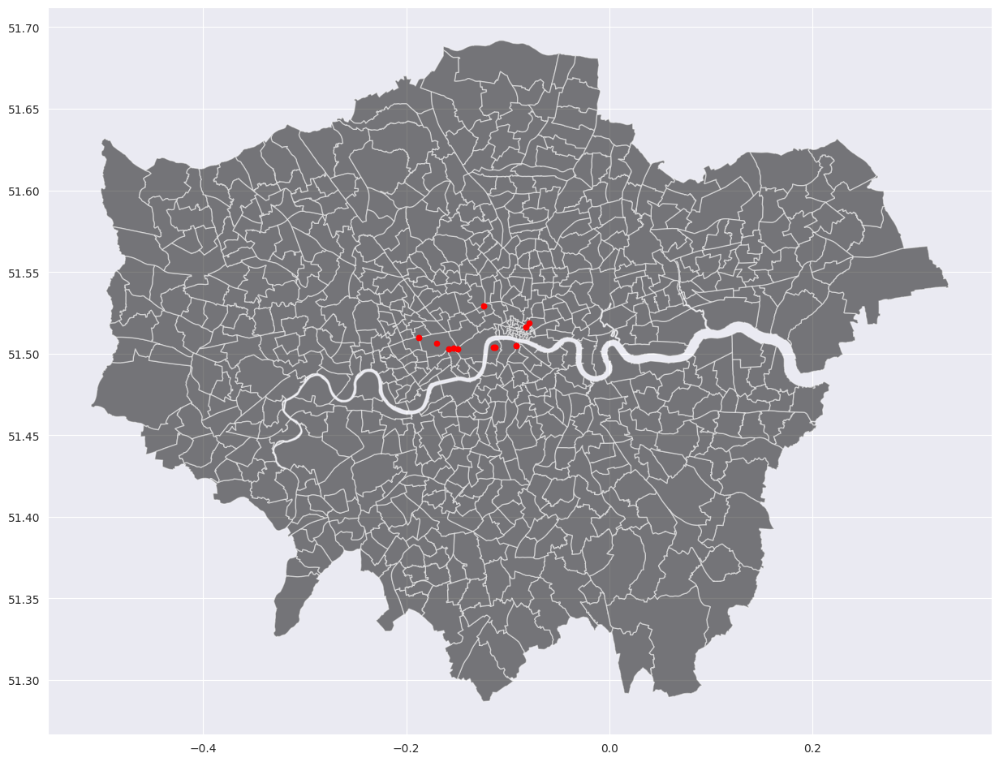

In [21]:
# @title Explore the station locations

most_popular_stations_rentals['geometry'] = [Point(xy) for xy in zip(most_popular_stations_rentals['start_station_longitude'], most_popular_stations_rentals['start_station_latitude'])]

geo_df_popular = create_geodataframe(most_popular_stations_rentals, most_popular_stations_rentals['geometry'])

fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax=ax, alpha=0.5, color='black')
geo_df_popular.plot(ax=ax,
                    markersize=20,
                    color='red',
                    marker='o',
                    label='Most popular start stations')


In [24]:
# @title Most popular start vs end stations

# Filter start stations and end stations separately
start_stations_df = most_popular_stations_rentals[most_popular_stations_rentals['station_type'] == 'start_station']
end_stations_df = most_popular_stations_rentals[most_popular_stations_rentals['station_type'] == 'end_station']

# Count common station names
common_station_names = len(set(start_stations_df['station_name']) & set(end_stations_df['station_name']))

print("Number of common station names:", common_station_names)

Number of common station names: 9


In [26]:
# @title Most popular vs all
most_popular_rentals = most_popular_stations_rentals[most_popular_stations_rentals['station_type'] == 'start_station']['no_of_rentals'].sum()
all_rentals = client.query('''
SELECT count(distinct rental_id) FROM take_home_test.stg_cycle_hire
''').to_dataframe()

print(most_popular_rentals/all_rentals*100)

        f0_
0  5.535496


In [27]:
# @title Get data for the unique bikes
most_popular_stations_bikes = client.query('''
with start_stations as (
SELECT
  'start_station' as station_type,
  start_station_name as station_name,
  start_station_longitude,
  start_station_latitude,
  start_station_distance_from_city_center as distance_from_city_center,
  sum(no_of_bikes) as no_of_bikes
FROM
  take_home_test.drv_fact_cycle_data
GROUP BY
  1, 2, 3, 4, 5
ORDER BY
  6 desc
LIMIT 10
)

, end_stations as (
SELECT
  'end_station' as station_type,
  end_station_name as station_name,
  end_station_longitude,
  end_station_latitude,
  end_station_distance_from_city_center as distance_from_city_center,
  sum(no_of_bikes) as no_of_bikes
FROM
  take_home_test.drv_fact_cycle_data
GROUP BY
  1, 2, 3, 4, 5
ORDER BY
  6 desc
LIMIT 10
)


SELECT *, rank() OVER (PARTITION BY station_type ORDER BY no_of_bikes desc) as rank_ FROM start_stations
UNION ALL
SELECT *, rank() OVER (PARTITION BY station_type ORDER BY no_of_bikes desc) as rank_ FROM end_stations
  ''').to_dataframe().sort_values(by=['station_type', 'no_of_bikes'], ascending=[False, False]).reset_index(drop=True)

In [28]:
most_popular_stations_bikes

,station_type,station_name,start_station_longitude,start_station_latitude,distance_from_city_center,no_of_bikes,rank_
0,start_station,"Hyde Park Corner, Hyde Park",-0.153521,51.503118,1.868185,670088,1
1,start_station,"Belgrove Street , King's Cross",-0.123944,51.529416,3.277742,593005,2
2,start_station,"Waterloo Station 3, Waterloo",-0.112824,51.503792,1.067971,527083,3
3,start_station,"Albert Gate, Hyde Park",-0.158456,51.502954,2.201972,459995,4
4,start_station,"Black Lion Gate, Kensington Gardens",-0.187843,51.509908,4.352853,458762,5
5,start_station,"Waterloo Station 1, Waterloo",-0.113864,51.504028,1.013547,419286,6
6,start_station,"Wellington Arch, Hyde Park",-0.149569,51.502740,1.591644,392448,7
7,start_station,"Hop Exchange, The Borough",-0.091774,51.504628,2.491961,385850,8
8,start_station,"Wormwood Street, Liverpool Street",-0.082422,51.516155,3.569991,354617,9
9,start_station,"Triangle Car Park, Hyde Park",-0.170280,51.506452,3.080330,352014,10


## Most popular stations during the weekend

In [53]:
# @title Filter the data
most_popular_stations_weekend = client.query('''
with start_stations as (
SELECT
  'start_station' as station_type,
  start_station_name as station_name,
  start_station_longitude,
  start_station_latitude,
  start_station_distance_from_city_center as distance_from_city_center,
  sum(no_of_rentals) as no_of_rentals,
FROM
  take_home_test.drv_fact_cycle_data
WHERE
  start_is_weekend = 1
GROUP BY
  1, 2, 3, 4, 5
ORDER BY
  6 desc
LIMIT 10
)

, end_stations as (
SELECT
  'end_station' as station_type,
  end_station_name as station_name,
  end_station_longitude,
  end_station_latitude,
  end_station_distance_from_city_center as distance_from_city_center,
  sum(no_of_rentals) as no_of_rentals
FROM
  take_home_test.drv_fact_cycle_data
WHERE
  start_is_weekend = 1
GROUP BY
  1, 2, 3, 4, 5
ORDER BY
  6 desc
LIMIT 10
)


SELECT *, rank() OVER (PARTITION BY station_type ORDER BY no_of_rentals desc) as rank_ FROM start_stations
UNION ALL
SELECT *, rank() OVER (PARTITION BY station_type ORDER BY no_of_rentals desc) as rank_ FROM end_stations
  ''').to_dataframe().sort_values(by=['station_type', 'no_of_rentals'], ascending=[False, False]).reset_index(drop=True)

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



<Axes: >

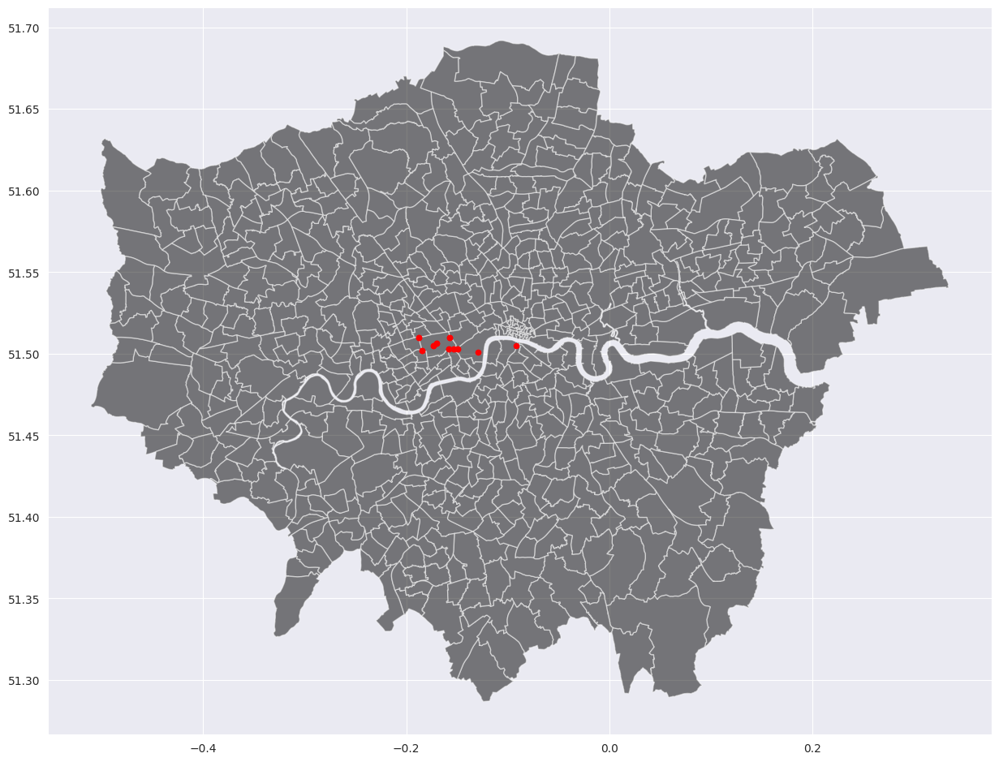

In [57]:
# @title Explore the station locations

most_popular_stations_weekend['geometry'] = [Point(xy) for xy in zip(most_popular_stations_weekend['start_station_longitude'], most_popular_stations_weekend['start_station_latitude'])]

geo_df_popular = create_geodataframe(most_popular_stations_weekend, most_popular_stations_weekend['geometry'])

fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax=ax, alpha=0.5, color='black')
geo_df_popular.plot(ax=ax,
                    markersize=20,
                    color='red',
                    marker='o',
                    label='Most popular start stations')


## Calculating flows

In [29]:
# @title Calculating Flows
def calculate_station_flows(df, metric):
    inflows = df.loc[:, ('start_station_id_backfilled', metric)].copy().groupby(['start_station_id_backfilled']).sum()
    inflows.reset_index(inplace=True)
    inflows.rename(columns={metric: 'inflows', 'start_station_id_backfilled': 'station_id'}, inplace=True)

    outflows = df.loc[:, ('end_station_id_backfilled', metric)].copy().groupby(['end_station_id_backfilled']).sum()
    outflows.reset_index(inplace=True)
    outflows.rename(columns={metric: 'outflows', 'end_station_id_backfilled': 'station_id'}, inplace=True)

    flows = inflows.merge(right=outflows, how='inner', on='station_id')

    flows['delta'] = flows['inflows'] - flows['outflows']
    flows['total_flows'] = flows['inflows'] + flows['outflows']

    return flows

In [60]:
flows = calculate_station_flows(drv_fact_cycle_data, 'no_of_rentals')
station_flows = flows.merge(right=dim_cycle_stations, how='left', on='station_id')
station_flows.head()

,station_id,inflows,outflows,delta,total_flows,station_name,longitude,latitude,distance_from_city_center,docks_count,bikes_count,empty_docks
0,1,14553,9662,4891,24215,"River Street , Clerkenwell",-0.109971,51.529163,3.450309,19,18,1
1,2,37062,38151,-1089,75213,"Phillimore Gardens, Kensington",-0.197574,51.499607,4.885406,37,26,11
2,3,16324,17653,-1329,33977,"Christopher Street, Liverpool Street",-0.084606,51.521284,3.769436,32,6,26
3,4,16298,16729,-431,33027,"St. Chad's Street, King's Cross",-0.120974,51.530059,3.368370,23,23,0
4,5,46905,49758,-2853,96663,"Sedding Street, Sloane Square",-0.156876,51.493130,2.204760,27,15,12


<Axes: xlabel='docks_count', ylabel='total_flows'>

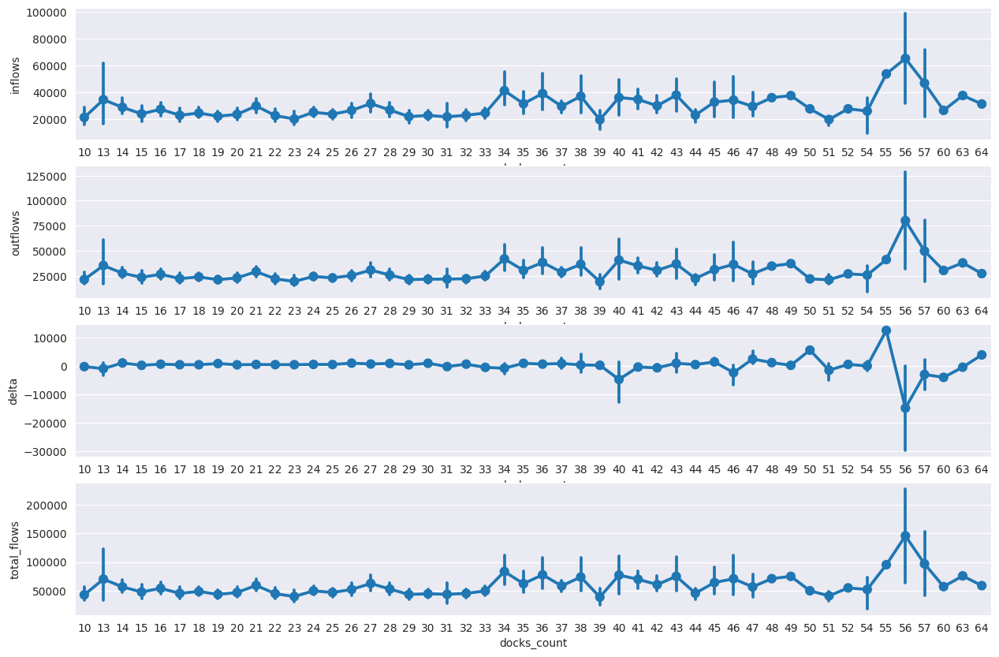

In [45]:
# @title Docks count vs traffic

fig, ax = plt.subplots(nrows = 4, ncols = 1, figsize = (15,10))
sns.pointplot(data = station_flows[station_flows['docks_count'].notnull()], x = "docks_count", y = "inflows", ax = ax[0])
sns.pointplot(data = station_flows[station_flows['docks_count'].notnull()], x = "docks_count", y = "outflows", ax = ax[1])
sns.pointplot(data = station_flows[station_flows['docks_count'].notnull()], x = "docks_count", y = "delta", ax = ax[2])
sns.pointplot(data = station_flows[station_flows['docks_count'].notnull()], x = "docks_count", y = "total_flows", ax = ax[3])

<Axes: xlabel='bikes_count', ylabel='total_flows'>

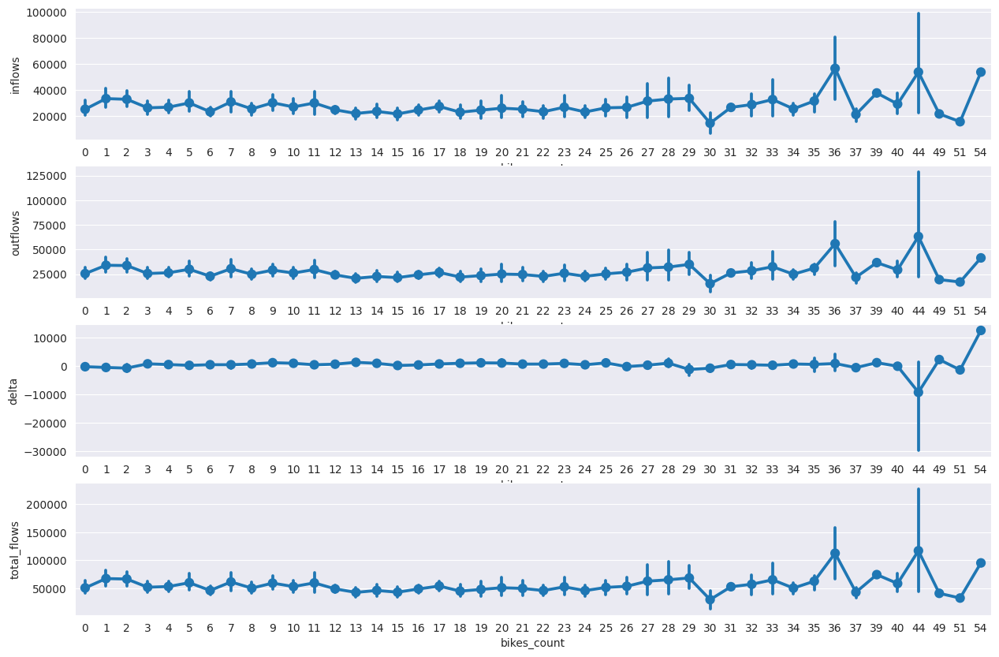

In [61]:
# @title Bikes count vs traffic

fig, ax = plt.subplots(nrows = 4, ncols = 1, figsize = (15,10))
sns.pointplot(data = station_flows[station_flows['bikes_count'].notnull()], x = "bikes_count", y = "inflows", ax = ax[0])
sns.pointplot(data = station_flows[station_flows['bikes_count'].notnull()], x = "bikes_count", y = "outflows", ax = ax[1])
sns.pointplot(data = station_flows[station_flows['bikes_count'].notnull()], x = "bikes_count", y = "delta", ax = ax[2])
sns.pointplot(data = station_flows[station_flows['bikes_count'].notnull()], x = "bikes_count", y = "total_flows", ax = ax[3])

In [46]:
station_flows.sort_values('delta', axis=0, inplace=True, ascending=True)
station_flows.head(10)

,station_id,inflows,outflows,delta,total_flows,station_name,longitude,latitude,distance_from_city_center,docks_count,bikes_count,empty_docks
189,194,98940,128582,-29642,227522,"Hop Exchange, The Borough",-0.091774,51.504628,2.491961,56,44,12
221,228,60531,78971,-18440,139502,"St. James's Square, St. James's",-0.134621,51.507425,0.979737,40,2,38
222,229,68157,79102,-10945,147259,"Whitehall Place, Strand",-0.123180,51.506543,0.774134,46,7,39
63,66,42051,50980,-8929,93031,"Holborn Circus, Holborn",-0.108657,51.517950,2.365463,40,0,40
243,251,80980,89470,-8490,170450,"Brushfield Street, Liverpool Street",-0.079249,51.518908,3.916788,34,1,33
106,109,72213,80448,-8235,152661,"Soho Square , Soho",-0.132329,51.515631,1.776835,57,29,28
98,101,48700,56385,-7685,105085,"Queen Street 1, Bank",-0.092940,51.511553,2.684668,22,2,20
548,579,57169,64004,-6835,121173,"Queen Street 2, Bank",-0.093051,51.511246,2.661718,36,1,35
61,64,44952,51744,-6792,96696,"William IV Street, Strand",-0.124749,51.509462,1.063611,26,22,4
668,703,24508,31156,-6648,55664,"St. Bride Street, Holborn",-0.105344,51.515060,2.247338,25,2,23


In [47]:
station_flows.sort_values('delta', axis=0, inplace=True, ascending=False)
station_flows.head(10)

,station_id,inflows,outflows,delta,total_flows,station_name,longitude,latitude,distance_from_city_center,docks_count,bikes_count,empty_docks
348,361,53827,41432,12395,95259,"Waterloo Station 2, Waterloo",-0.113426,51.503920,1.035714,55,54,1
496,524,37877,28064,9813,65941,"Lancaster Gate , Bayswater",-0.179668,51.511654,3.868730,38,9,29
90,93,21937,13067,8870,35004,"Cloudesley Road, Angel",-0.109025,51.534409,4.023153,37,23,14
43,45,38082,29918,8164,68000,"Boston Place, Marylebone",-0.162298,51.522511,3.497510,26,20,6
215,222,27391,20174,7217,47565,"Knightsbridge, Hyde Park",-0.155350,51.502757,1.986128,43,0,43
149,153,72916,66216,6700,139132,"Bayswater Road, Hyde Park",-0.174411,51.511933,3.539511,27,7,20
544,574,51296,44710,6586,96006,"Eagle Wharf Road, Hoxton",-0.093150,51.533560,4.405882,45,25,20
40,42,32019,25639,6380,57658,"Wenlock Road , Hoxton",-0.093904,51.530992,4.137715,28,28,0
338,351,37237,31146,6091,68383,"Macclesfield Rd, St Lukes",-0.097122,51.529423,3.870214,28,22,6
239,247,25547,19545,6002,45092,"St. John's Wood Church, The Regent's Park",-0.167515,51.530529,4.402682,50,18,32


In [48]:
# @title PageRank
data_for_rank = drv_fact_cycle_data.loc[:, ('start_station_name', 'end_station_name', 'no_of_rentals')].groupby(['start_station_name', 'end_station_name']).sum()
data_for_rank.reset_index(inplace=True)
data_for_rank.rename(columns={'no_of_rentals': 'Count'}, inplace=True)

In [49]:
data_for_rank.head()

,start_station_name,end_station_name,Count
0,"Abbey Orchard Street, Westminster","Abbey Orchard Street, Westminster",824
1,"Abbey Orchard Street, Westminster","Aberdeen Place, St. John's Wood",1
2,"Abbey Orchard Street, Westminster","Abingdon Green, Westminster",55
3,"Abbey Orchard Street, Westminster","Abingdon Villas, Kensington",8
4,"Abbey Orchard Street, Westminster","Abyssinia Close, Clapham Junction",5


In [51]:
network = nx.from_pandas_edgelist(data_for_rank, 'start_station_name', 'end_station_name', edge_attr=['Count'])

pagerank = pd.DataFrame(list(nx.pagerank(network).items()), columns = ['station_name', 'Rank'])

pagerank.sort_values('Rank', axis=0, inplace=True, ascending=False)
pagerank.reset_index(inplace=True, drop=True)

pagerank = pagerank.loc[:, ('station_name', 'Rank')]

pagerank[:10]

,station_name,Rank
0,"Wormwood Street, Liverpool Street",0.001432
1,"Little Argyll Street, West End",0.001427
2,"Hop Exchange, The Borough",0.001427
3,"Belgrove Street , King's Cross",0.001424
4,"Soho Square , Soho",0.001424
5,"Whitehall Place, Strand",0.001422
6,"Queen Street 2, Bank",0.001421
7,"Craven Street, Strand",0.001421
8,"William IV Street, Strand",0.001420
9,"Green Park Station, Mayfair",0.001420


In [52]:
print(network)

Graph with 843 nodes and 285268 edges


## Commuting Patterns

In [53]:
# @title Filter dataset to only look at mornings and evenings to see commuting patterns
all_mornings = drv_fact_cycle_data[
    (drv_fact_cycle_data['start_is_weekend'] == 0) &
    (drv_fact_cycle_data['start_date_time'].dt.hour.between(7, 10))]

all_evenings = drv_fact_cycle_data[
    (drv_fact_cycle_data['start_is_weekend'] == 0) &
    (drv_fact_cycle_data['start_date_time'].dt.hour.between(17, 20))]

In [55]:
# @title Prepare data

all_mornings_flows = calculate_station_flows(all_mornings, 'no_of_rentals')
all_evenings_flows = calculate_station_flows(all_mornings, 'no_of_rentals')

all_mornings_flows.rename(columns={'delta': 'mornings'}, inplace=True)
all_evenings_flows.rename(columns={'delta': 'evenings'}, inplace=True)

mornings_evenings = all_mornings_flows.merge(right=all_evenings_flows, on='station_id', how='inner')

mornings_evenings['c_mornings'] = mornings_evenings.apply(lambda x: 'red' if x['mornings'] < 0 else 'green', axis=1)
mornings_evenings['c_evenings'] = mornings_evenings.apply(lambda x: 'red' if x['evenings'] < 0 else 'green', axis=1)

mornings_evenings = mornings_evenings[['station_id', 'c_mornings', 'c_evenings']]

mornings_evenings = mornings_evenings.merge(right=dim_cycle_stations, how='inner', on='station_id')

#mornings_evenings = mornings_evenings.drop('station_id', axis=1)

mornings_evenings = mornings_evenings.groupby(['station_name', 'c_mornings', 'c_evenings']).agg(
    longitude=('longitude', 'mean'),
    latitude=('latitude', 'mean'),
    docks_count=('docks_count', 'mean')
).reset_index()

geometry = [Point(xy) for xy in zip(mornings_evenings['longitude'], mornings_evenings['latitude'])]

mornings_evenings['geometry'] = [Point(xy) for xy in zip(mornings_evenings['longitude'], mornings_evenings['latitude'])]
geo_df = create_geodataframe(mornings_evenings, mornings_evenings['geometry'])

,station_name,c_mornings,c_evenings,longitude,latitude,docks_count
0,"Abbey Orchard Street, Westminster",red,red,-0.132102,51.498126,29.0
1,"Abbotsbury Road, Holland Park",green,green,-0.205991,51.501391,24.0
2,"Aberdeen Place, St. John's Wood",green,green,-0.176268,51.524826,18.0
3,"Aberfeldy Street, Poplar",green,green,-0.005659,51.513548,16.0
4,"Abingdon Green, Westminster",red,red,-0.125972,51.497640,20.0


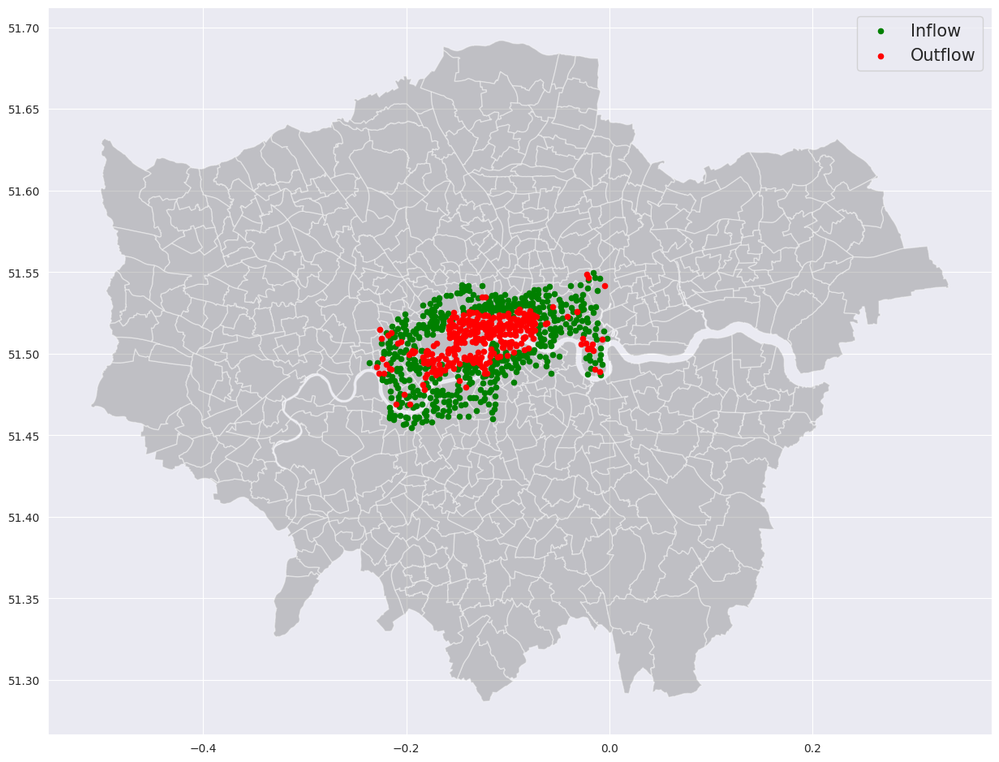

In [58]:
# @title Morning commute

fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax=ax, alpha=0.4, color='grey')
geo_df[geo_df['c_mornings'] == 'green'].plot(ax=ax,
                                       markersize=20,
                                       color='green',
                                       marker='o',
                                       label='Inflow')
geo_df[geo_df['c_mornings'] == 'red'].plot(ax=ax,
                                       markersize=20,
                                       color='red',
                                       marker='o',
                                       label='Outflow')
plt.legend(prop={'size':15})

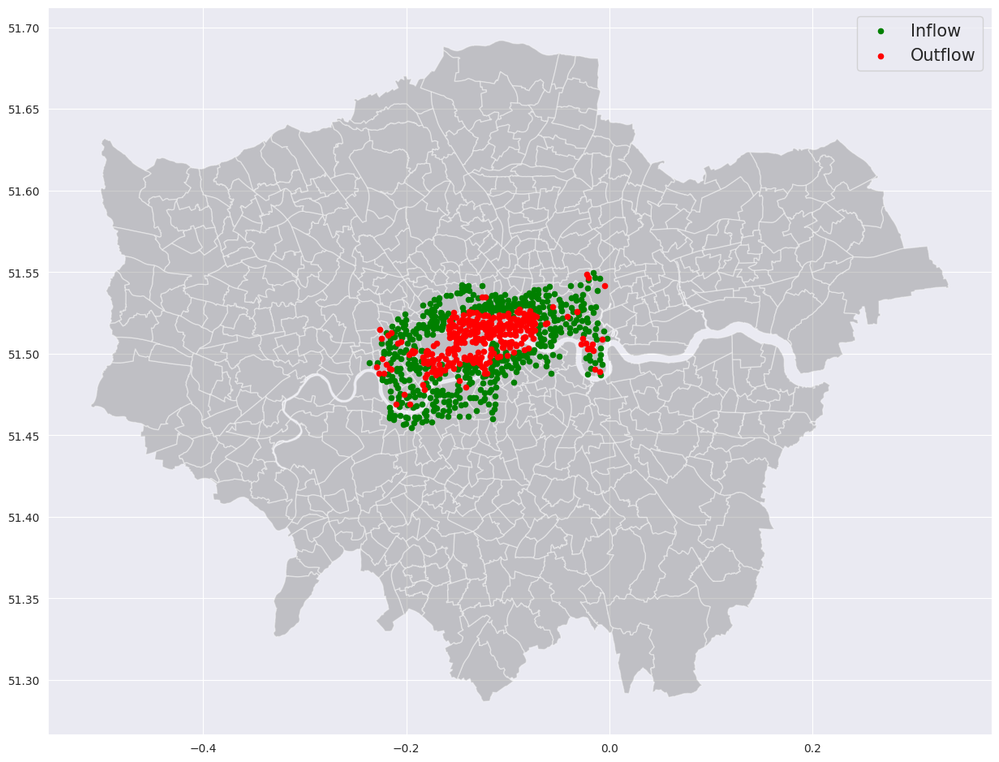

In [59]:
# @title Evening commute

fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax=ax, alpha=0.4, color='grey')
geo_df[geo_df['c_evenings'] == 'green'].plot(ax=ax,
                                       markersize=20,
                                       color='green',
                                       marker='o',
                                       label='Inflow')
geo_df[geo_df['c_evenings'] == 'red'].plot(ax=ax,
                                       markersize=20,
                                       color='red',
                                       marker='o',
                                       label='Outflow')
plt.legend(prop={'size':15})

# Rental durations

In [5]:
# @title Filter dim_cycle_stations

### Throw away all the datapoints thats longer than a day to not to skew the axis to infinity

filtered_durations = dim_cycle_data[
    dim_cycle_data['duration_min'].notnull() &
    (dim_cycle_data['is_over_a_day'] == 0) &
    (dim_cycle_data['start_date_time'] >= '2021-01-01') &
    (dim_cycle_data['start_date_time'] <= '2022-12-31')
][['duration_min', 'start_season', 'is_ebike', 'start_is_weekend']]

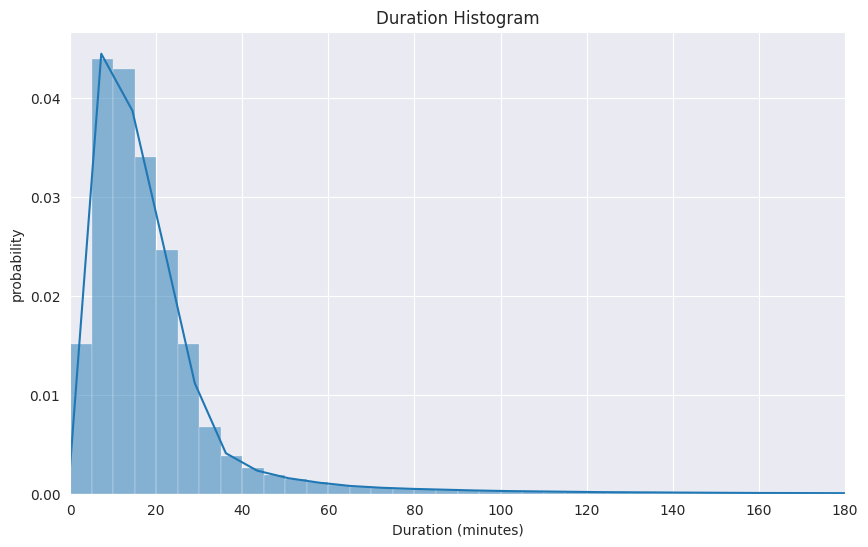

In [6]:
# @title Durations distribution

plt.figure(figsize=(10, 6))
sns.histplot(data=filtered_durations, x='duration_min', kde = True, binwidth = 5, binrange=(0,180), stat = 'density')
plt.title('Duration Histogram')
plt.xlabel('Duration (minutes)')
plt.ylabel('probability')
plt.xlim(0, 180)
plt.show()

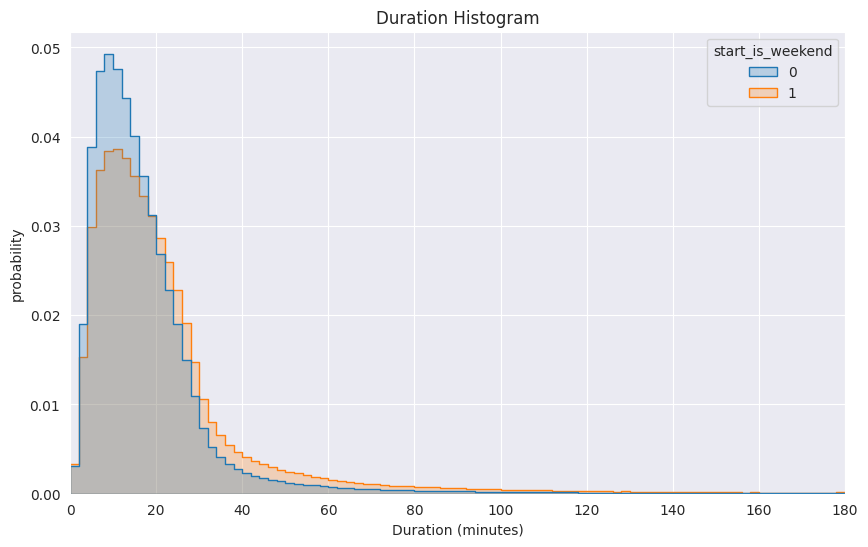

In [14]:
# @title Durations distribution by is_weekend

plt.figure(figsize=(10, 6))
sns.histplot(data=filtered_durations, x='duration_min', binwidth = 2, binrange=(0,180), stat = 'density', hue = 'start_is_weekend', element="step", common_norm=False)
plt.title('Duration Histogram')
plt.xlabel('Duration (minutes)')
plt.ylabel('probability')
plt.xlim(0, 180)
plt.show()

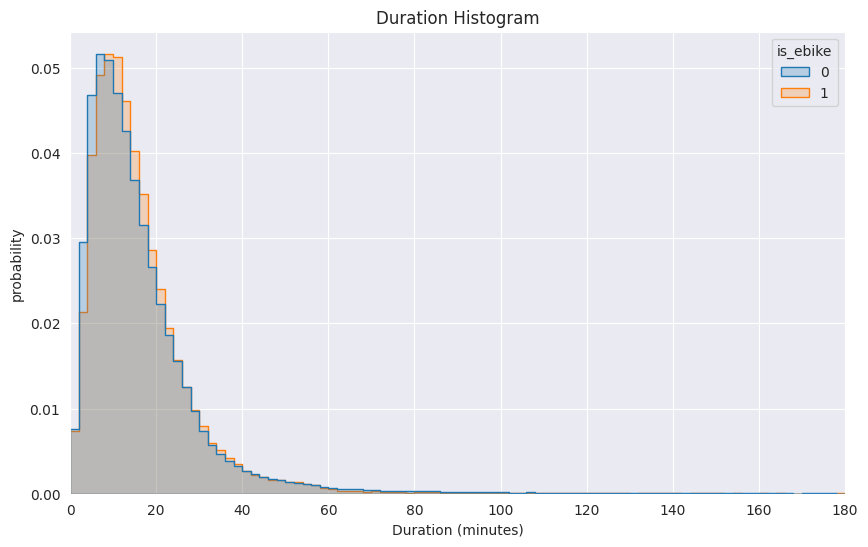

In [15]:
# @title Durations distribution by is_ebike


plt.figure(figsize=(10, 6))
sns.histplot(data=filtered_durations[filtered_durations['is_ebike'].notnull()], x='duration_min', binwidth = 2, binrange=(0,180), stat = 'density', hue = 'is_ebike', element="step", common_norm=False)
plt.title('Duration Histogram')
plt.xlabel('Duration (minutes)')
plt.ylabel('probability')
plt.xlim(0, 180)
plt.show()

In [11]:
# @title Durations distribution by start_season

season_mapping = {
     1: 'spring',
     2: 'summer',
     3: 'fall',
     4: 'winter',
}

# Use the map function to recode 'start_season' to integers
filtered_durations['start_season_str'] = filtered_durations['start_season'].map(season_mapping)

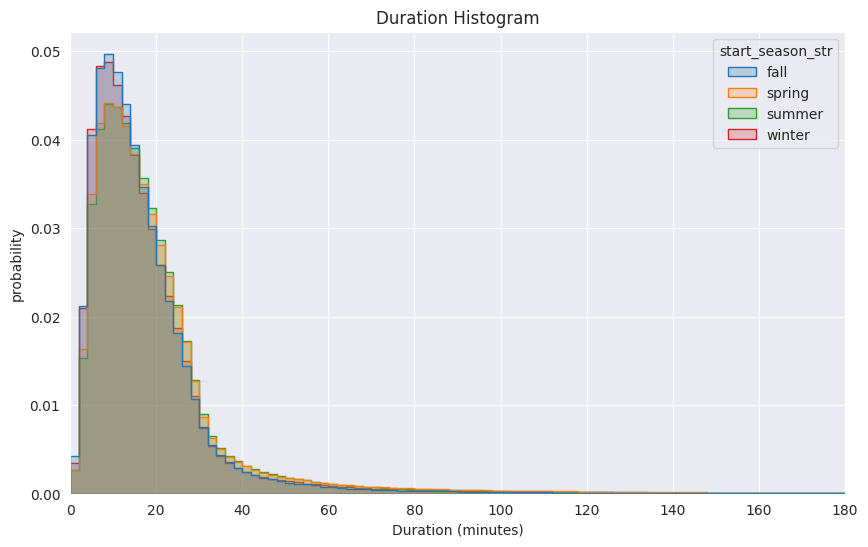

In [16]:
plt.figure(figsize=(10, 6))
sns.histplot(data=filtered_durations, x='duration_min', binwidth = 2, binrange=(0,180), stat = 'density', hue = 'start_season_str', element="step", common_norm=False)
plt.title('Duration Histogram')
plt.xlabel('Duration (minutes)')
plt.ylabel('probability')
plt.xlim(0, 180)
plt.show()

# Seasonality and forecast

In [6]:
# @title Create rentals hourly & daily for decomposition and forecasting

rentals_hourly = drv_fact_cycle_data.groupby('start_date_time')['no_of_rentals'].sum().reset_index()

rentals_daily = rentals_hourly.copy()
rentals_daily['start_date'] = pd.to_datetime(rentals_hourly['start_date_time']).dt.date
rentals_daily = rentals_daily.groupby('start_date')['no_of_rentals'].sum().reset_index()

In [8]:
# @title Transform to be used by Prophet

#df = dim_cycle_data[["start_date_time", "no_of_rentals"]]
#result['start_date_time'] = pd.to_datetime(result['start_date_time'])
rentals_hourly.columns = ['ds', 'y']
rentals_daily.columns = ['ds', 'y']
rentals_hourly['ds'] = rentals_hourly['ds'].apply(lambda x: x.replace(tzinfo=None))

In [9]:
# @title Train the daily model

daymodel = Prophet()
daymodel.add_country_holidays(country_name='UK')
daymodel.fit(rentals_daily)
dayfuture = daymodel.make_future_dataframe(periods=365)
daypred = daymodel.predict(dayfuture)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb58l9djw/hacg2vx2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb58l9djw/du_lx4du.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8797', 'data', 'file=/tmp/tmpb58l9djw/hacg2vx2.json', 'init=/tmp/tmpb58l9djw/du_lx4du.json', 'output', 'file=/tmp/tmpb58l9djw/prophet_model7qdl7kdm/prophet_model-20230828003217.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
00:32:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:32:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [11]:
# @title Train the daily & hourly model

daymodel = Prophet()
daymodel.add_country_holidays(country_name='UK')
daymodel.fit(rentals_daily)
dayfuture = daymodel.make_future_dataframe(periods=365)
daypred = daymodel.predict(dayfuture)

hourmodel = Prophet()
hourmodel.fit(rentals_hourly)
hourfuture = hourmodel.make_future_dataframe(periods=365, freq='H')
hourpred = hourmodel.predict(hourfuture)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb58l9djw/zonu9nmk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb58l9djw/uyug3lqi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=92779', 'data', 'file=/tmp/tmpb58l9djw/zonu9nmk.json', 'init=/tmp/tmpb58l9djw/uyug3lqi.json', 'output', 'file=/tmp/tmpb58l9djw/prophet_modelx4c1fvwh/prophet_model-20230828003337.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
00:33:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
00:33:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb58l9djw/twwm8cjj.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpb58l9djw/coayvmc4.json
DEBUG:cmdstanpy:

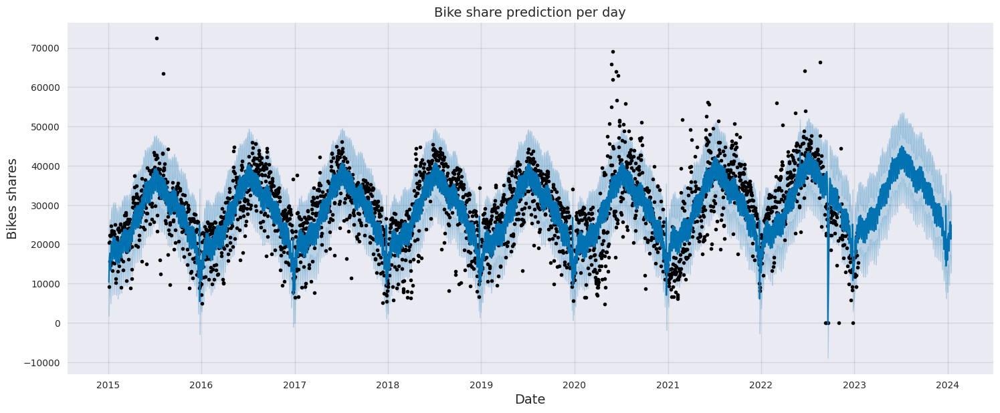

In [12]:
# @title Plot the day forecast
f, ax = plt.subplots(1)
f.set_figheight(6)
f.set_figwidth(15)

daymodel.plot(daypred, ax=ax)

ax.set_title('Bike share prediction per day', fontsize=14)
ax.set_xlabel(xlabel='Date', fontsize=14)
ax.set_ylabel(ylabel='Bikes shares', fontsize=14)

plt.show()

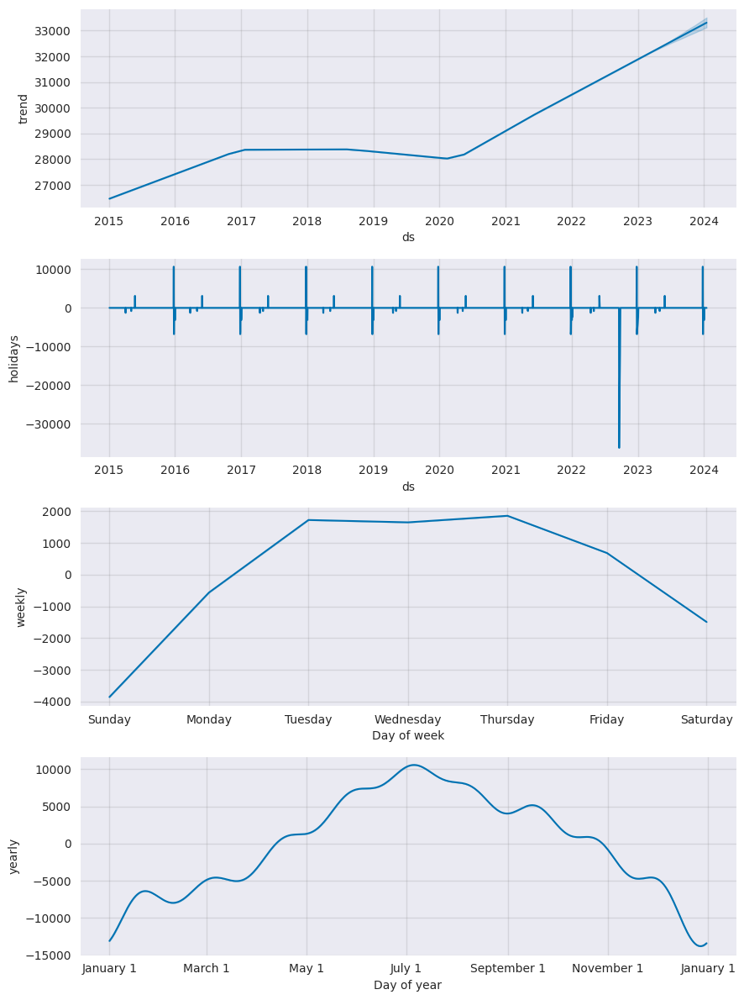

In [13]:
# @title Decompose the day forecast

daymodel.plot_components(daypred)
plt.show()

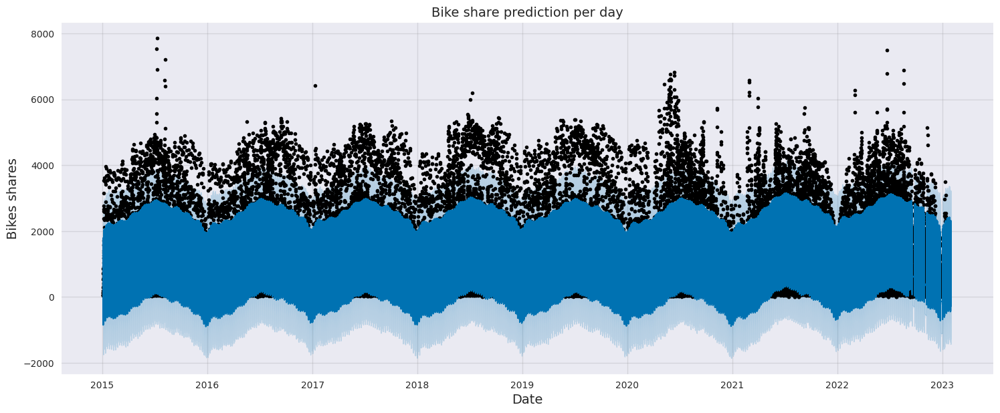

In [14]:
# @title Plot the hour forecast

f, ax = plt.subplots(1)
f.set_figheight(6)
f.set_figwidth(15)

hourmodel.plot(hourpred, ax=ax)

ax.set_title('Bike share prediction per day', fontsize=14)
ax.set_xlabel(xlabel='Date', fontsize=14)
ax.set_ylabel(ylabel='Bikes shares', fontsize=14)

plt.show()

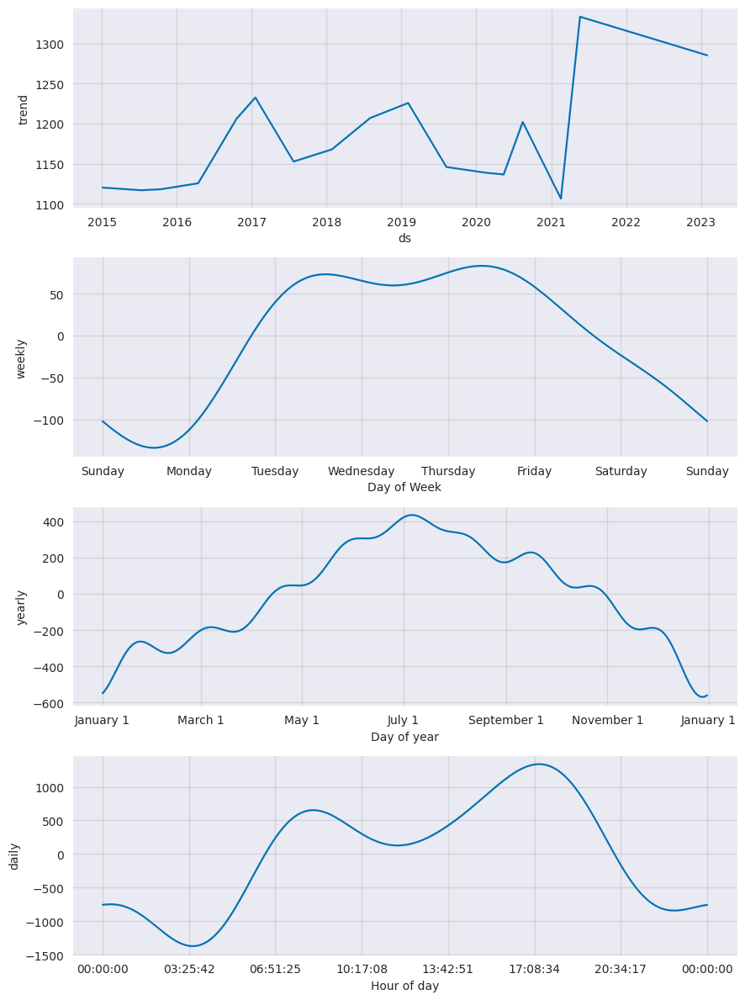

In [15]:
# @title Decompose the hour forecast

hourmodel.plot_components(hourpred)
plt.show()

In [ ]:
add_date_features(drv_fact_cycle_data, 'start_station_date_time')

In [ ]:
fig, ax = plt.subplots(nrows = 4, ncols = 1, figsize = (20,15))
sns.pointplot(data = weather_merged, x = "hour", y = "no_of_rentals", ax = ax[0])
sns.pointplot(data = weather_merged, x = "hour", y = "no_of_rentals", hue = "is_holiday", ax = ax[1])
sns.pointplot(data = weather_merged, x = "hour", y = "no_of_rentals", hue = "is_weekend", ax = ax[2])
sns.pointplot(data = weather_merged, x = "hour", y = "no_of_rentals", hue = "season", ax = ax[3]);

# Analysing the London weather data


In [19]:
# @title Create the drv_fact_weather_merged table

drv_fact_weather_merged = client.query('''
SELECT
  timestamp,
  t1 as temp_real,
  t2 as temp_feel,
  hum as humidity,
  wind_speed,
  weather_code,
  is_holiday,
  is_weekend,
  season,
  count(distinct rental_id) as no_of_rentals,
FROM
  take_home_test.weatherstats_london_source wd
LEFT JOIN
  take_home_test.cycle_hire_source c on timestamp_trunc(c.start_date, HOUR) = wd.timestamp
GROUP BY
  1, 2, 3, 4, 5, 6, 7, 8, 9
''').to_dataframe()

In [22]:
# @title Transform and add features to the drv_fact_weather_merged table

timestamp_column = drv_fact_weather_merged['timestamp']
no_of_rentals_column = drv_fact_weather_merged['no_of_rentals']
drv_fact_weather_merged = drv_fact_weather_merged.drop(columns=['timestamp', 'no_of_rentals'])
drv_fact_weather_merged.insert(0, 'no_of_rentals', no_of_rentals_column)
drv_fact_weather_merged.insert(0, 'timestamp', timestamp_column)
add_date_features(drv_fact_weather_merged, 'timestamp')

,timestamp,no_of_rentals,temp_real,temp_feel,humidity,wind_speed,weather_code,is_holiday,is_weekend,season,year,month,day_of_month,day_of_week,hour
0,2016-03-17 06:00:00+00:00,571,2.5,0.0,90.0,9.0,2.0,0.0,0.0,0.0,2016,3,17,3,6
1,2016-02-09 02:00:00+00:00,37,6.5,2.5,68.5,22.0,2.0,0.0,0.0,3.0,2016,2,9,1,2
2,2016-02-23 10:00:00+00:00,827,7.0,4.0,71.0,17.0,2.0,0.0,0.0,3.0,2016,2,23,1,10
3,2016-02-11 15:00:00+00:00,1119,8.0,6.0,53.0,11.0,2.0,0.0,0.0,3.0,2016,2,11,3,15
4,2016-11-23 17:00:00+00:00,3114,10.0,8.0,82.0,15.0,2.0,0.0,0.0,2.0,2016,11,23,2,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17409,2016-02-24 02:00:00+00:00,49,2.0,2.0,87.0,4.0,1.0,0.0,0.0,3.0,2016,2,24,2,2
17410,2015-02-25 03:00:00+00:00,34,7.0,4.5,81.0,14.0,2.0,0.0,0.0,3.0,2015,2,25,2,3
17411,2016-10-27 03:00:00+00:00,57,11.0,11.0,94.0,11.0,3.0,0.0,0.0,2.0,2016,10,27,3,3
17412,2015-02-10 03:00:00+00:00,21,4.0,4.0,93.0,4.0,4.0,0.0,0.0,3.0,2015,2,10,1,3


<ipython-input-23-0e84020e6114>:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

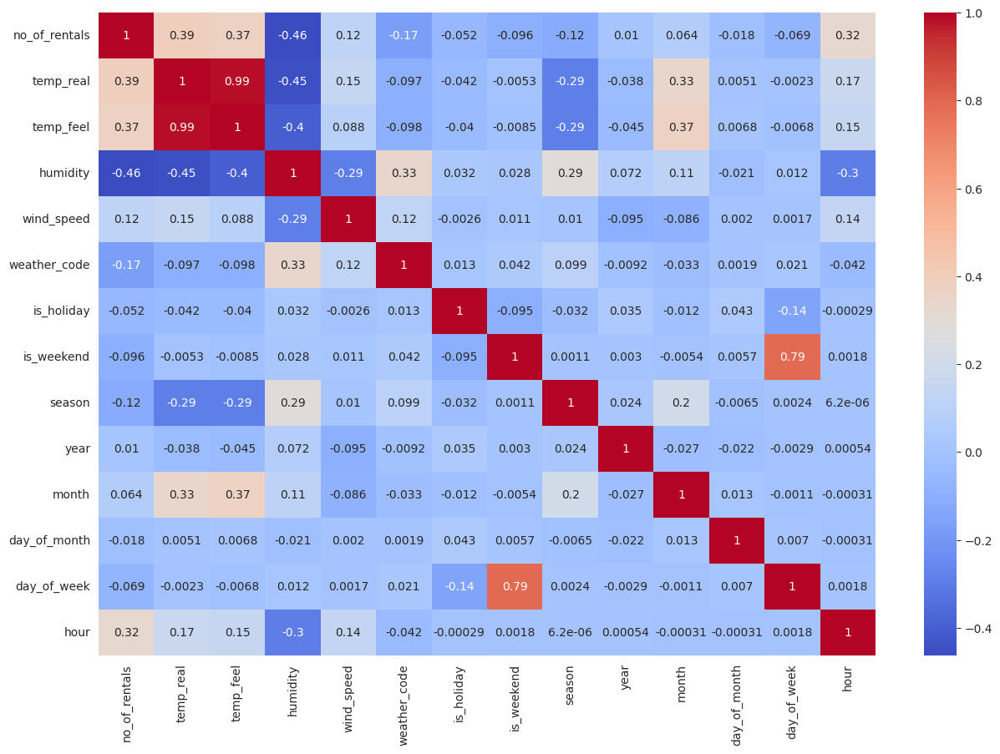

In [23]:
# @title Create a correlation map to analyse

plt.figure(figsize=(15,10))
sns.heatmap(drv_fact_weather_merged.corr(), annot = True, cmap = 'coolwarm')

In [24]:
# @title Check for multicollinearity

df_temp = drv_fact_weather_merged.corr()

count = "Done"
feature =[]
collinear=[]
for col in df_temp.columns:
    for i in df_temp.index:
        if (df_temp[col][i]> .9 and df_temp[col][i] < 1) or (df_temp[col][i]< -.9 and df_temp[col][i] > -1) :
                feature.append(col)
                collinear.append(i)
                print(Fore.RED + f"\033[1mmulticolinearity alert in between\033[0m {col} - {i}")
        else:
            print(f"For {col} and {i}, there is NO multicollinearity problem")

print("\033[1mThe number of strong corelated features:\033[0m", count)

For no_of_rentals and no_of_rentals, there is NO multicollinearity problem
For no_of_rentals and temp_real, there is NO multicollinearity problem
For no_of_rentals and temp_feel, there is NO multicollinearity problem
For no_of_rentals and humidity, there is NO multicollinearity problem
For no_of_rentals and wind_speed, there is NO multicollinearity problem
For no_of_rentals and weather_code, there is NO multicollinearity problem
For no_of_rentals and is_holiday, there is NO multicollinearity problem
For no_of_rentals and is_weekend, there is NO multicollinearity problem
For no_of_rentals and season, there is NO multicollinearity problem
For no_of_rentals and year, there is NO multicollinearity problem
For no_of_rentals and month, there is NO multicollinearity problem
For no_of_rentals and day_of_month, there is NO multicollinearity problem
For no_of_rentals and day_of_week, there is NO multicollinearity problem
For no_of_rentals and hour, there is NO multicollinearity problem
For temp_

<ipython-input-24-f0142f842423>:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<ipython-input-25-b83ff1f64be0>:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



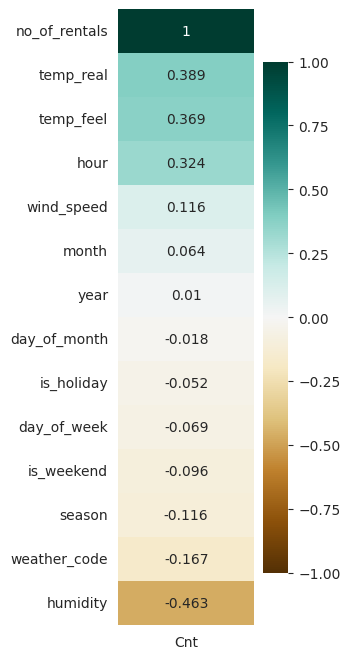

In [25]:
# @title Shrink the correlations to the no_of_rentals

target_variable = round(drv_fact_weather_merged.corr()["no_of_rentals"].sort_values(ascending=False), 3)
target_variable_df = pd.DataFrame({"Cnt": target_variable.values},
                                    index=target_variable.index)
plt.figure(figsize=(2.2,8))
sns.heatmap(target_variable_df, vmin=-1, vmax=1, annot=True, fmt="g", cmap = 'BrBG')
plt.show()

<Axes: >

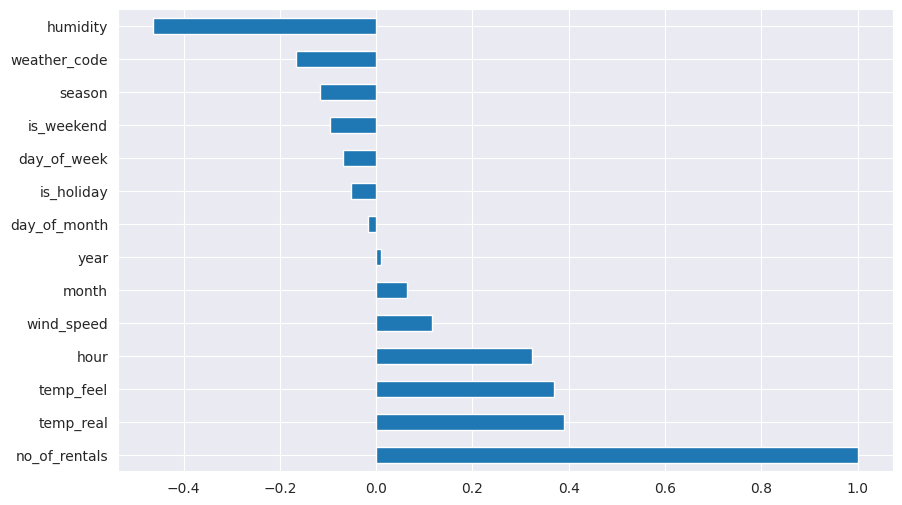

In [27]:
# correlation for target variable with pandas

plt.figure(figsize=(10,6))
target_variable.plot(x = target_variable.index, y = target_variable.values, kind = "barh", figsize = (10,6))

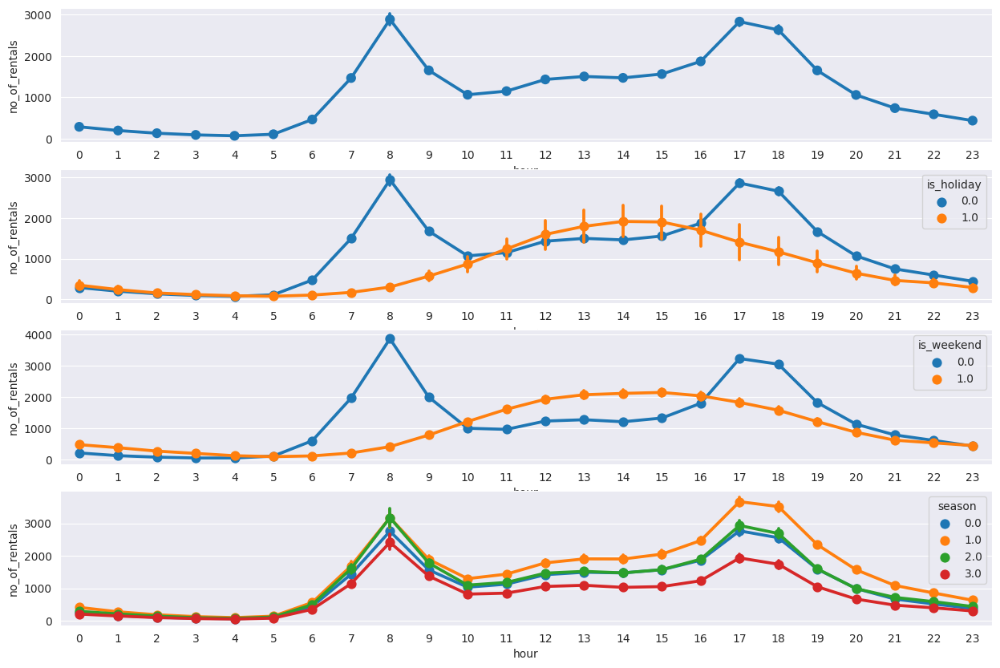

In [28]:
# @title No. of rentals slice and dice

fig, ax = plt.subplots(nrows = 4, ncols = 1, figsize = (15,10))
sns.pointplot(data = drv_fact_weather_merged, x = "hour", y = "no_of_rentals", ax = ax[0])
sns.pointplot(data = drv_fact_weather_merged, x = "hour", y = "no_of_rentals", hue = "is_holiday", ax = ax[1])
sns.pointplot(data = drv_fact_weather_merged, x = "hour", y = "no_of_rentals", hue = "is_weekend", ax = ax[2])
sns.pointplot(data = drv_fact_weather_merged, x = "hour", y = "no_of_rentals", hue = "season", ax = ax[3]);